# Import Libraries

In [17]:
import os
import sys
import time
import random
import json
import csv
import shutil
import warnings
from pathlib import Path
warnings.filterwarnings('ignore')


from sklearn.preprocessing import label_binarize
from sklearn.metrics import (
    confusion_matrix, classification_report, precision_score, recall_score, f1_score,
    roc_curve, auc, precision_recall_curve, average_precision_score, roc_auc_score
)
from sklearn.manifold import TSNE
import umap  

# Core Libraries
import numpy as np
import pandas as pd

# Progress Bars & Tables
from tqdm import tqdm
from tabulate import tabulate

# Image Processing
from PIL import Image
import cv2
from skimage.io import imread
from skimage import filters
from skimage.color import rgb2hsv
from skimage.feature import canny

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# Feature Extraction / Statistics
from scipy.stats import entropy
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# ML / Evaluation
from sklearn.model_selection import train_test_split
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import (
    precision_score, recall_score, f1_score, roc_auc_score,
    confusion_matrix, classification_report
)

# Deep Learning (TensorFlow/Keras)
import tensorflow as tf
from tensorflow.keras import Model, Input
from tensorflow.keras.optimizers import Adam,Nadam,SGD,RMSprop,Adagrad,Adadelta,Adamax
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout, Concatenate
)
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, CSVLogger, ModelCheckpoint
from tensorflow.keras.optimizers import Nadam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, applications, models,Model, Input
from tensorflow.keras import backend as K


# CNN Backbones
from tensorflow.keras.applications import MobileNet, DenseNet121

print("All Library Imported Successfully....")


All Library Imported Successfully....


# Dataset Directory

In [9]:
dataset_name = "Imbalanced_3_Dataset_Combined"
dataset = {
    "name": "Imbalanced_3_Dataset_Combined",
    "train": r"E:\Combine3_dataset\Training",
    "test":  r"E:\Combine3_dataset\Testing",
    "output": r"E:\models\Combine3_dataset\Imbalance",
    "class_names": ["Glioma", "Meningioma", "Pituitary", "No-Tumor"],
    "num_classes": 4
}

# Dataset EDA


📊 Processing Imbalanced_Combined


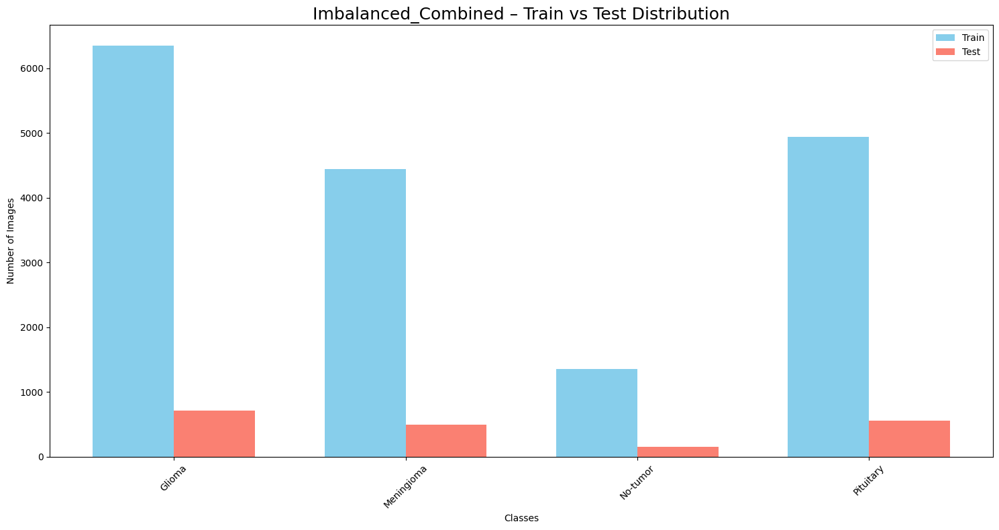


📊 Processing Balanced_Data001


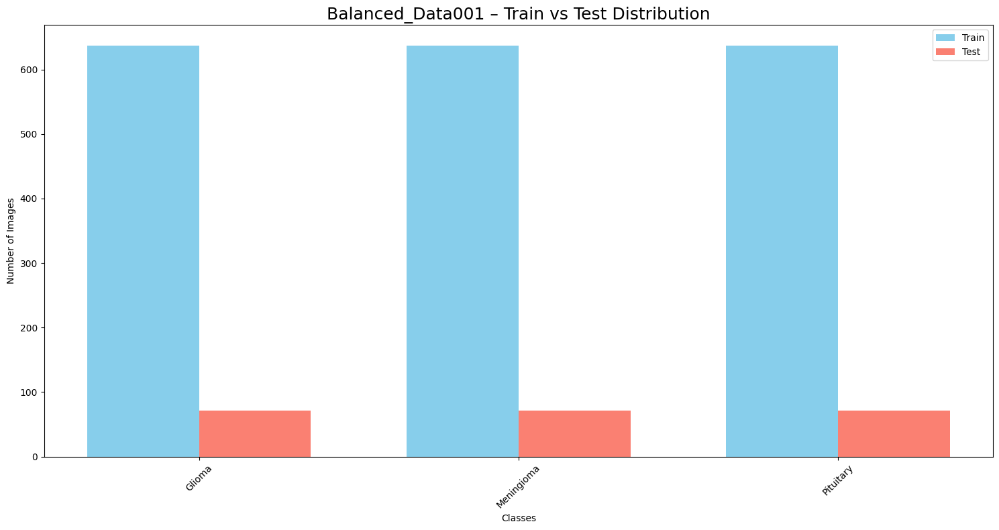


📌 Dataset Summary:
               Dataset  Train_Images  Test_Images  Total_Images  Num_Classes  \
0  Imbalanced_Combined         17082         1902         18984            4   
1     Balanced_Data001          1911          213          2124            3   

   Imbalance_Ratio  
0              4.7  
1              1.0  

📏 Computing stats for Imbalanced_Combined
Imbalanced_Combined Stats:
 {'mean_width': 468.9325, 'min_width': 205, 'max_width': 1024, 'std_width': 112.87911872330506, 'mean_height': 470.5875, 'min_height': 198, 'max_height': 830, 'std_height': 107.72543731055354, 'mean_aspect_ratio': 0.9946224335641083, 'std_aspect_ratio': 0.04712068934494094, 'mean_RGB': [39.304128223546954, 39.304128223546954, 39.304128223546954], 'std_RGB': [44.042969897178466, 44.042969897178466, 44.042969897178466]}

📏 Computing stats for Balanced_Data001
Balanced_Data001 Stats:
 {'mean_width': 507.73333333333335, 'min_width': 256, 'max_width': 512, 'std_width': 32.7728885242394, 'mean_height': 50

KeyError: 'Imbalanced_Data001'

In [5]:
def get_all_classes(root_path: str) -> list:
    """Return a sorted list of sub-folder names (the classes)."""
    root = Path(root_path)
    if not root.exists():
        raise FileNotFoundError(f"Path not found: {root}")
    return sorted([d.name for d in root.iterdir() if d.is_dir()])

def get_class_distribution(directory):
    class_counts = {}
    for cls in os.listdir(directory):
        class_path = os.path.join(directory, cls)
        if os.path.isdir(class_path):
            class_counts[cls] = len(os.listdir(class_path))
    return class_counts


def plot_train_test_bars(train_counts, test_counts, dataset_name):
    classes = list(train_counts.keys())
    train_vals = [train_counts.get(c, 0) for c in classes]
    test_vals = [test_counts.get(c, 0) for c in classes]

    x = np.arange(len(classes))
    width = 0.35

    plt.figure(figsize=(15, 8))
    plt.bar(x - width / 2, train_vals, width, label='Train', color='skyblue')
    plt.bar(x + width / 2, test_vals, width, label='Test', color='salmon')
    plt.xlabel("Classes")
    plt.ylabel("Number of Images")
    plt.title(f"{dataset_name} – Train vs Test Distribution",fontsize=18)
    plt.xticks(x, classes, rotation=45)
    plt.legend()
    plt.tight_layout()
    plt.show()

def compute_image_stats(directory, sample_size=200):
    """
    Computes:
      - Avg/min/max width & height
      - Aspect ratios
      - RGB mean and std
    """
    widths, heights, aspect_ratios = [], [], []
    means, stds = [], []

    # Get class directories
    class_dirs = [
        os.path.join(directory, c)
        for c in os.listdir(directory)
        if os.path.isdir(os.path.join(directory, c))
    ]

    # Loop through classes
    for class_path in class_dirs:
        # Filter valid images
        imgs = [
            f for f in os.listdir(class_path)
            if f.lower().endswith(('.png', '.jpg', '.jpeg'))
        ][:sample_size]

        for img_name in imgs:
            img_path = os.path.join(class_path, img_name)
            img = cv2.imread(img_path)

            if img is None:
                continue

            h, w = img.shape[:2]

            widths.append(w)
            heights.append(h)
            aspect_ratios.append(w / h if h > 0 else 0)

            means.append(np.mean(img, axis=(0, 1)))
            stds.append(np.std(img, axis=(0, 1)))

    # Prevent empty dataset crash
    if not widths:
        return {"error": "No valid images found in dataset."}

    return {
        "mean_width": float(np.mean(widths)),
        "min_width": int(np.min(widths)),
        "max_width": int(np.max(widths)),
        "std_width": float(np.std(widths)),

        "mean_height": float(np.mean(heights)),
        "min_height": int(np.min(heights)),
        "max_height": int(np.max(heights)),
        "std_height": float(np.std(heights)),

        "mean_aspect_ratio": float(np.mean(aspect_ratios)),
        "std_aspect_ratio": float(np.std(aspect_ratios)),

        "mean_RGB": np.mean(means, axis=0).tolist(),
        "std_RGB": np.mean(stds, axis=0).tolist()
    }

def show_one_image_per_class(directory):
    classes = [c for c in os.listdir(directory) if os.path.isdir(os.path.join(directory, c))]
    n_classes = len(classes)
    plt.figure(figsize=(5 * n_classes, 5))  

    for i, cls in enumerate(classes):
        cls_path = os.path.join(directory, cls)
        img_name = random.choice(os.listdir(cls_path))
        img = cv2.imread(os.path.join(cls_path, img_name))[:, :, ::-1]

        plt.subplot(1, n_classes, i + 1)
        plt.imshow(img)
        plt.title(cls, fontsize=18)
        plt.axis("off")

    plt.tight_layout()
    plt.show()

summary_rows = []

for name, paths in datasets.items():
    print(f"\n📊 Processing {name}")

    train_dist = get_class_distribution(paths["train"])
    test_dist = get_class_distribution(paths["test"])

    plot_train_test_bars(train_dist, test_dist, name)

    total_train = sum(train_dist.values())
    total_test = sum(test_dist.values())

    imbalance_ratio = max(train_dist.values()) / (min(train_dist.values()) + 1e-6)

    summary_rows.append({
        "Dataset": name,
        "Train_Images": total_train,
        "Test_Images": total_test,
        "Total_Images": total_train + total_test,
        "Num_Classes": len(train_dist),
        "Imbalance_Ratio": round(imbalance_ratio, 2)
    })

summary_df = pd.DataFrame(summary_rows)
print("\n📌 Dataset Summary:")
print(summary_df)

for name, paths in datasets.items():
    print(f"\n📏 Computing stats for {name}")
    stats = compute_image_stats(paths["train"])
    print(f"{name} Stats:\n", stats)

show_one_image_per_class(datasets["Imbalanced_Data001"]["train"])
show_one_image_per_class(datasets["Balanced_Data001"]["train"])


=== Imbalanced_Data001 – Metadata ===


,file,size_bytes,format,timestamp
0,1861_1.jpg,15729,JPEG,2025-10-22 06:19:03.626669645
1,113.jpg,14192,JPEG,2025-08-18 10:54:57.111485481
2,1025.jpg,27872,JPEG,2025-08-18 10:55:00.076427221
3,122.jpg,17512,JPEG,2025-08-18 10:54:57.143605232
4,128_1.jpg,16549,JPEG,2025-10-22 06:19:38.400843859


Formats: ['JPEG']
Avg size: 18852 bytes

=== Balanced_Data001 – Metadata ===


,file,size_bytes,format,timestamp
0,138.jpg,17355,JPEG,2025-08-18 10:56:54.179106951
1,178.jpg,13626,JPEG,2025-08-18 10:57:01.157285929
2,1076.jpg,11425,JPEG,2025-08-18 10:57:12.844754696
3,1923.jpg,13313,JPEG,2025-08-18 10:57:03.505235671
4,1037.jpg,25786,JPEG,2025-08-18 10:57:18.047720909


Formats: ['JPEG']
Avg size: 18955 bytes

=== Imbalanced_Data001 – One image per class ===


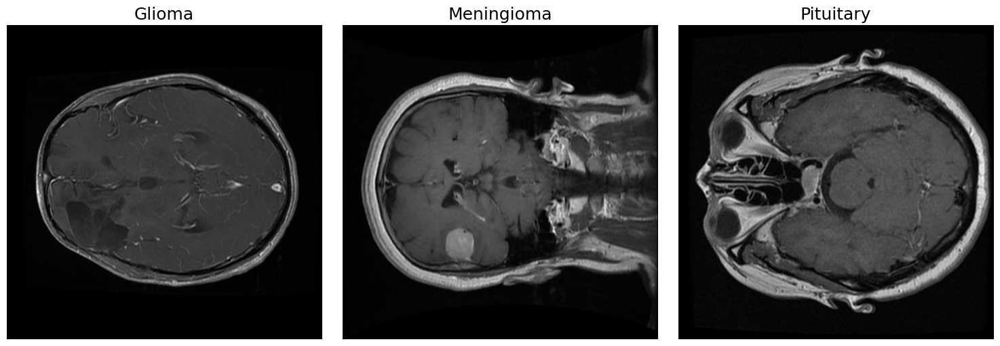


=== Balanced_Data001 – One image per class ===


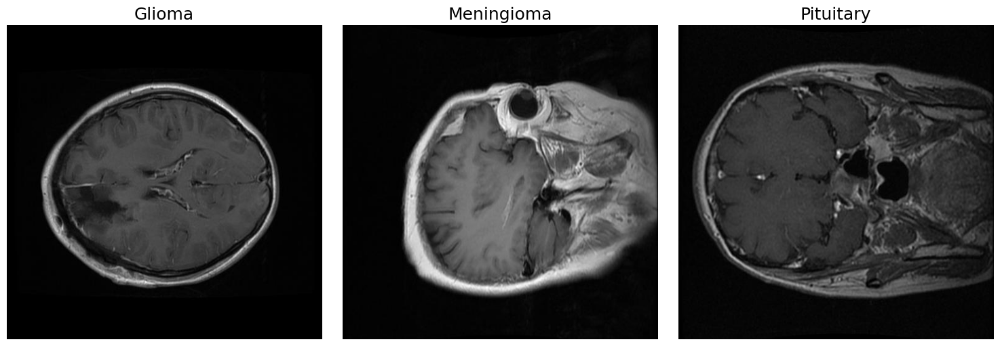


=== Imbalanced_Data001 – Before/After (per class) ===


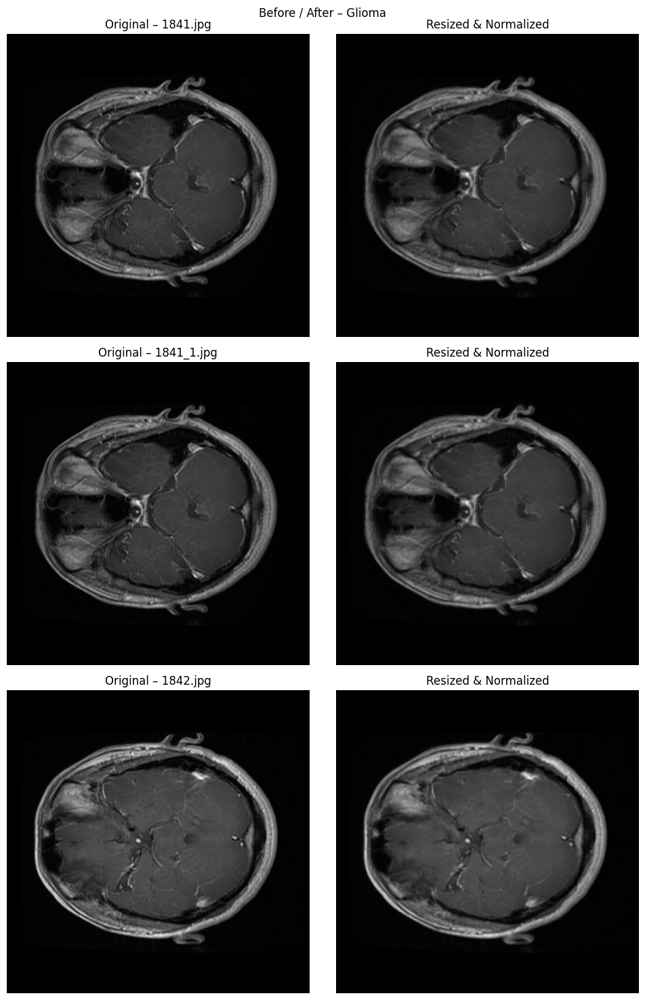

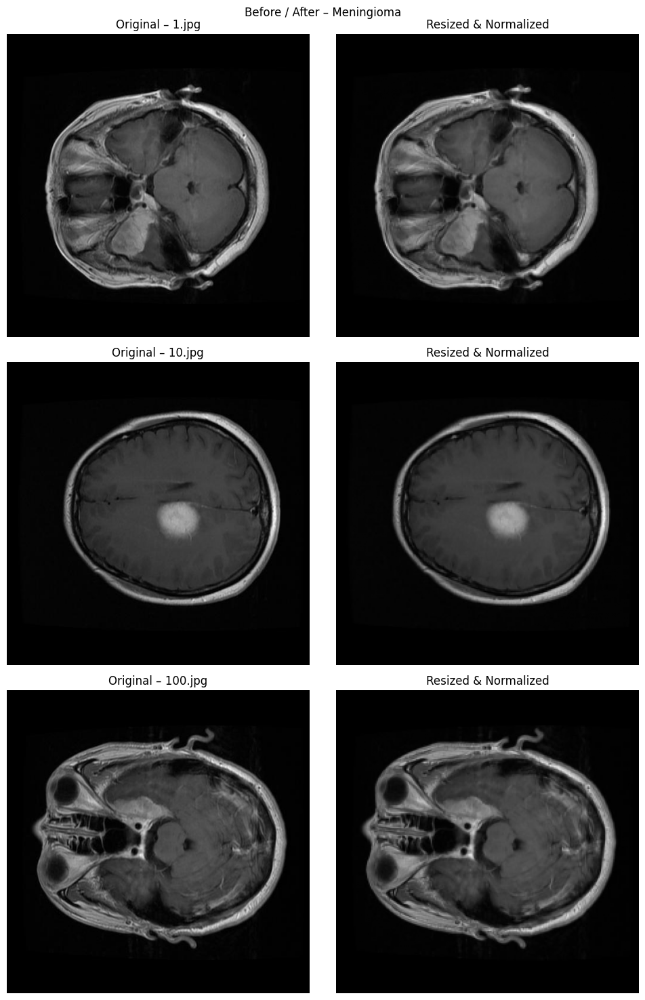

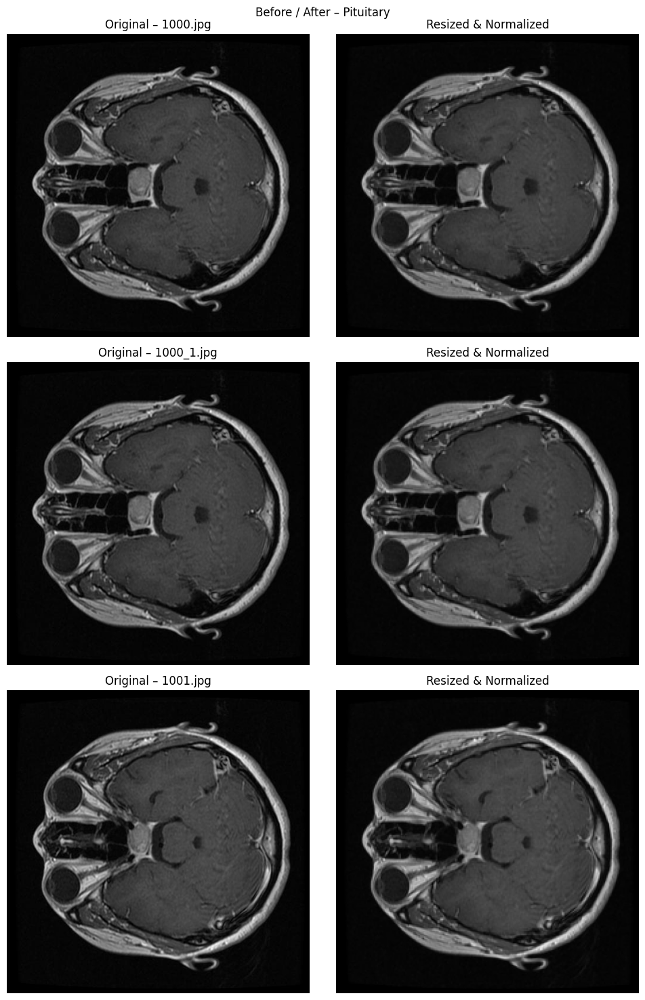


=== Balanced_Data001 – Before/After (per class) ===


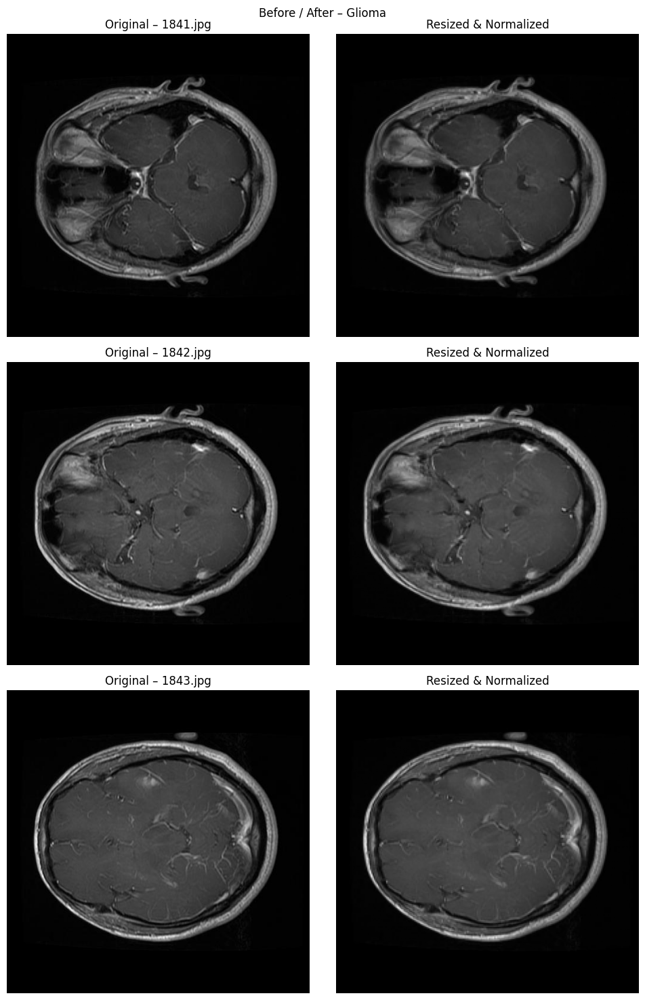

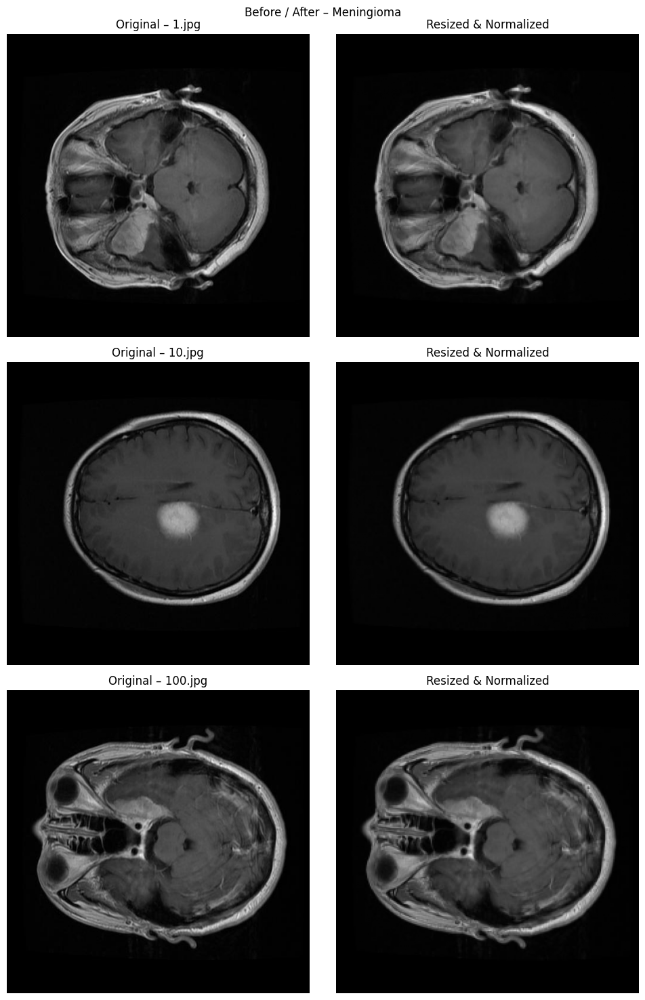

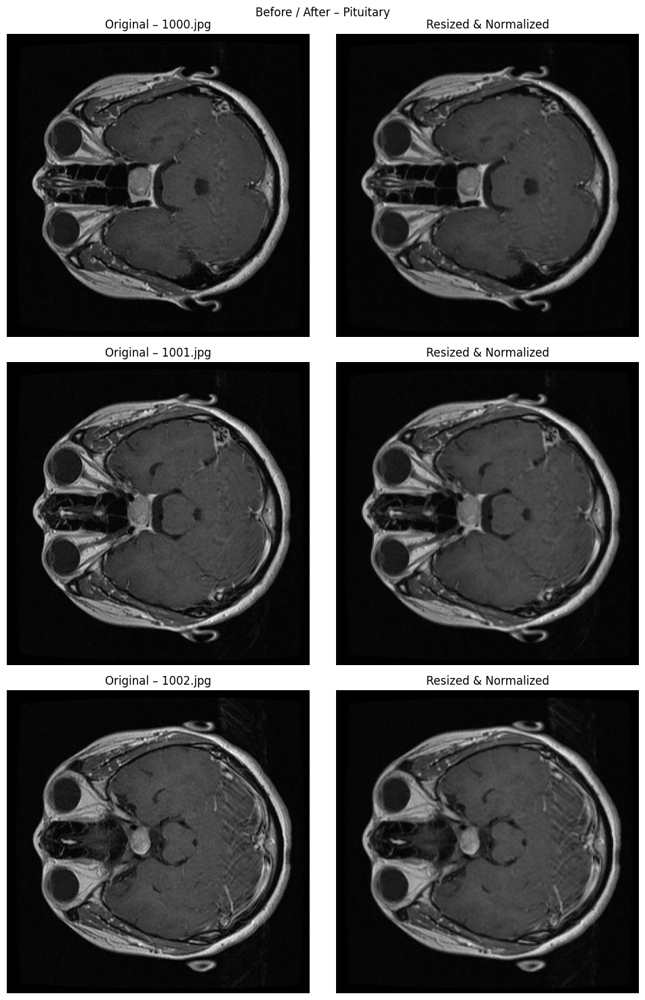

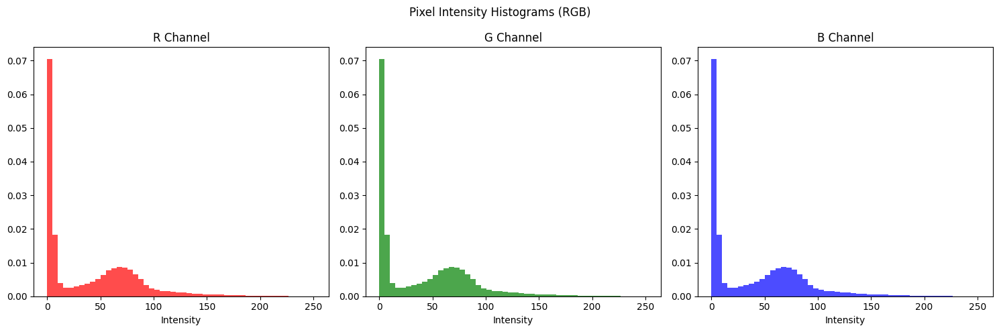

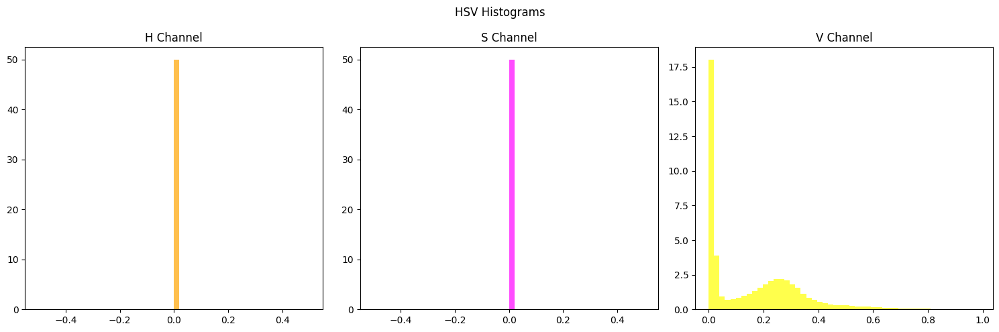

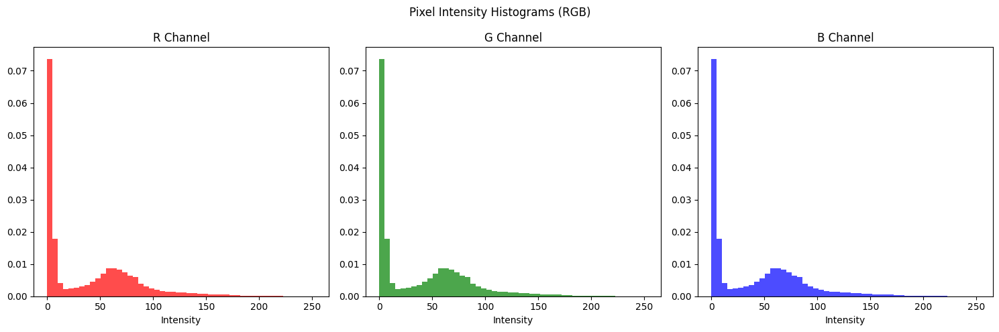

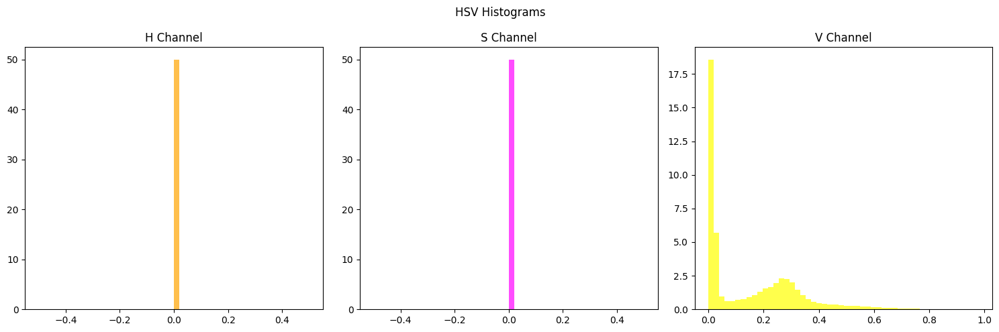

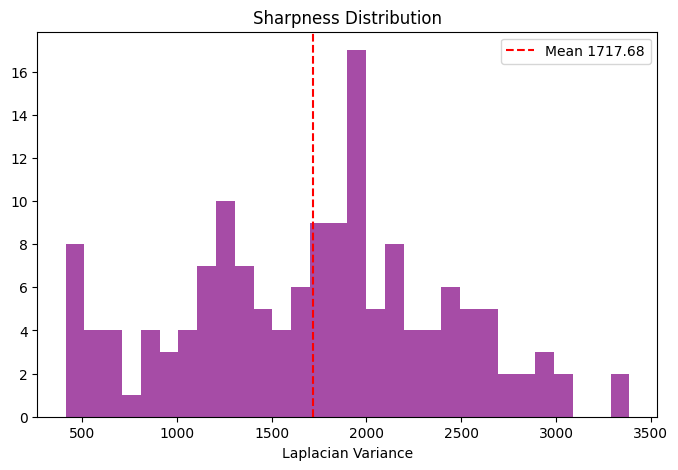

Imbalanced_Data001 – Sharpness mean: 1717.68 ± 688.66


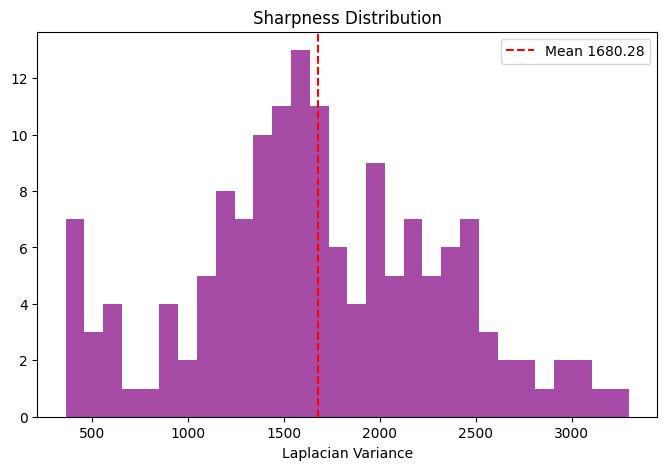

Balanced_Data001 – Sharpness mean: 1680.28 ± 649.31

=== Imbalanced_Data001 – Edge overlays ===


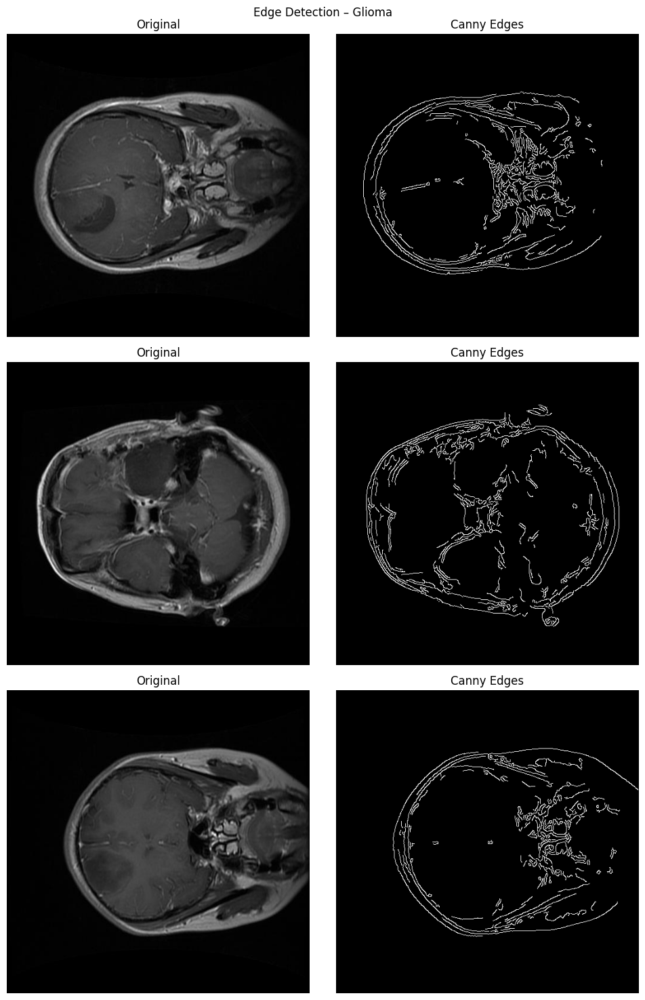

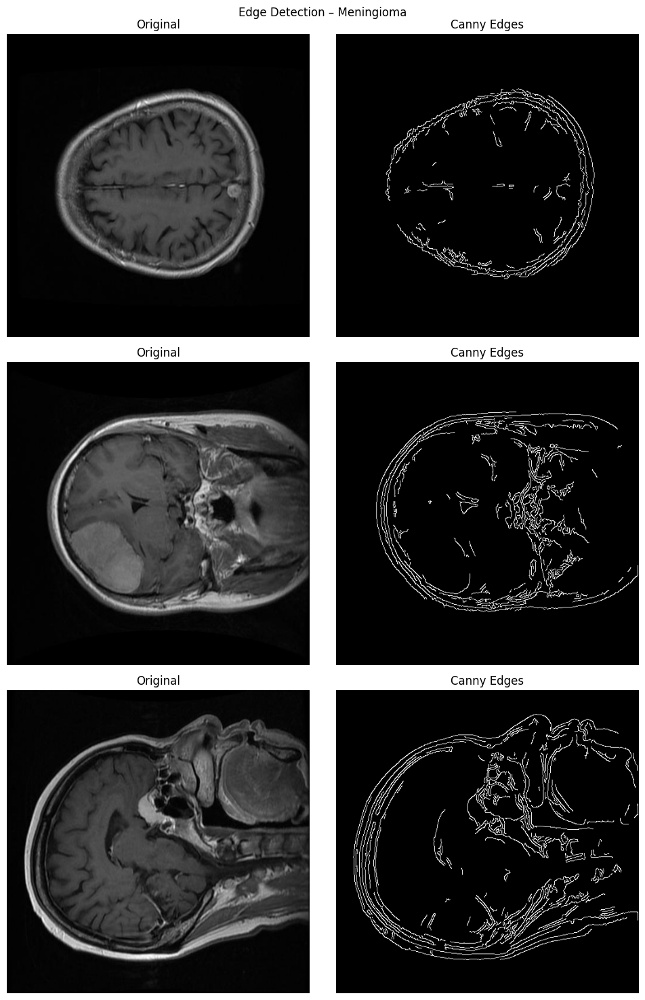

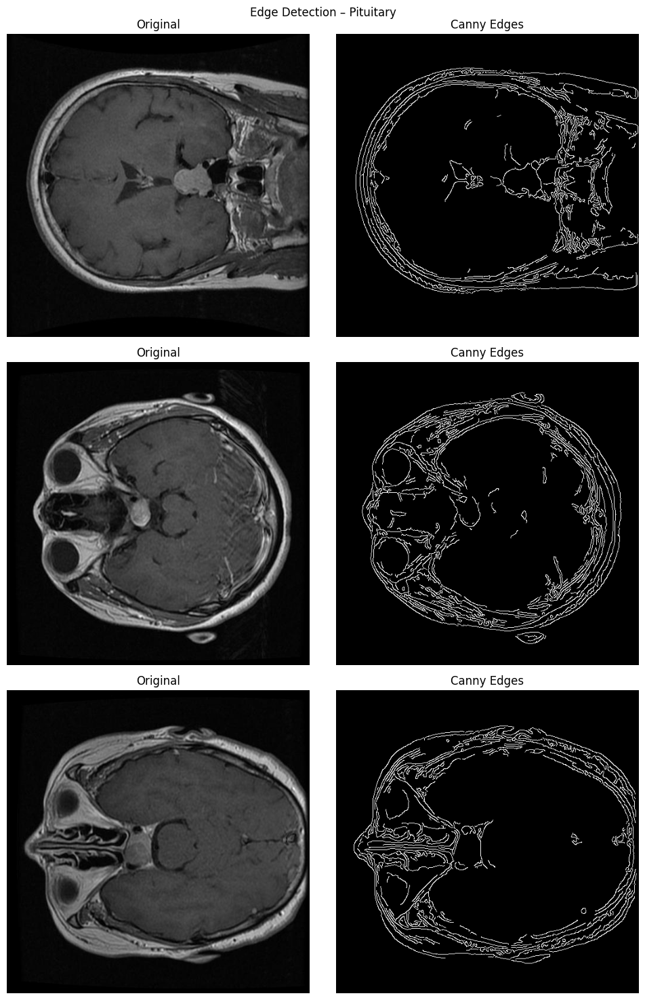


=== Balanced_Data001 – Edge overlays ===


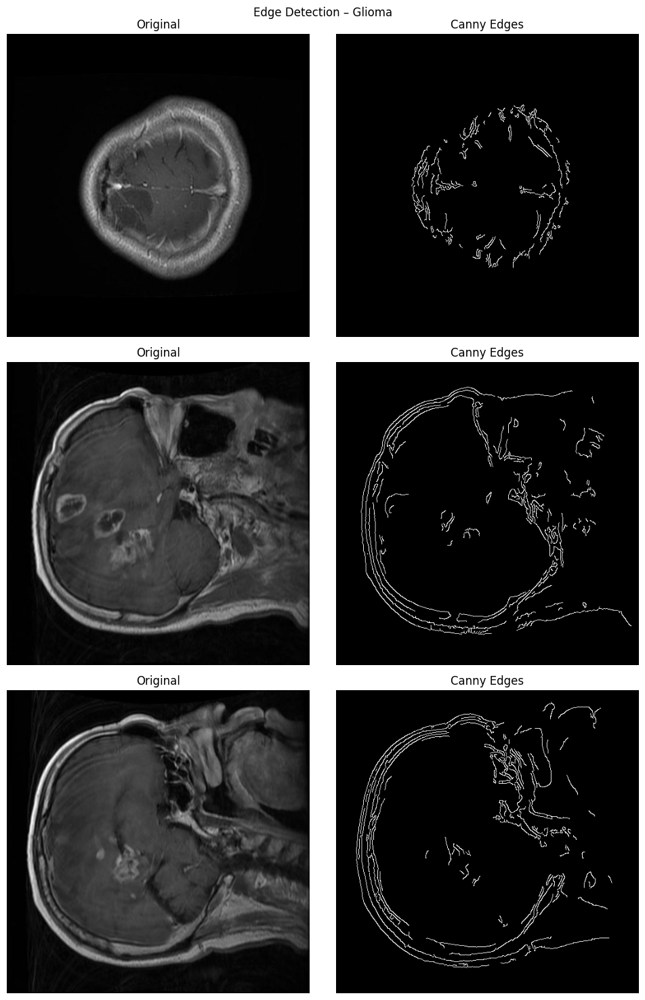

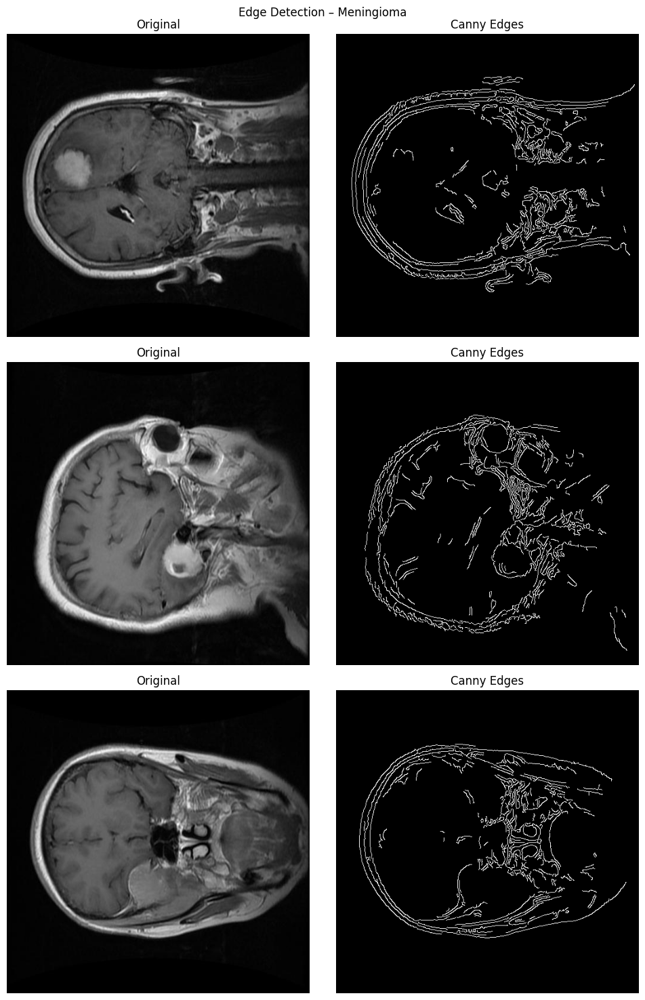

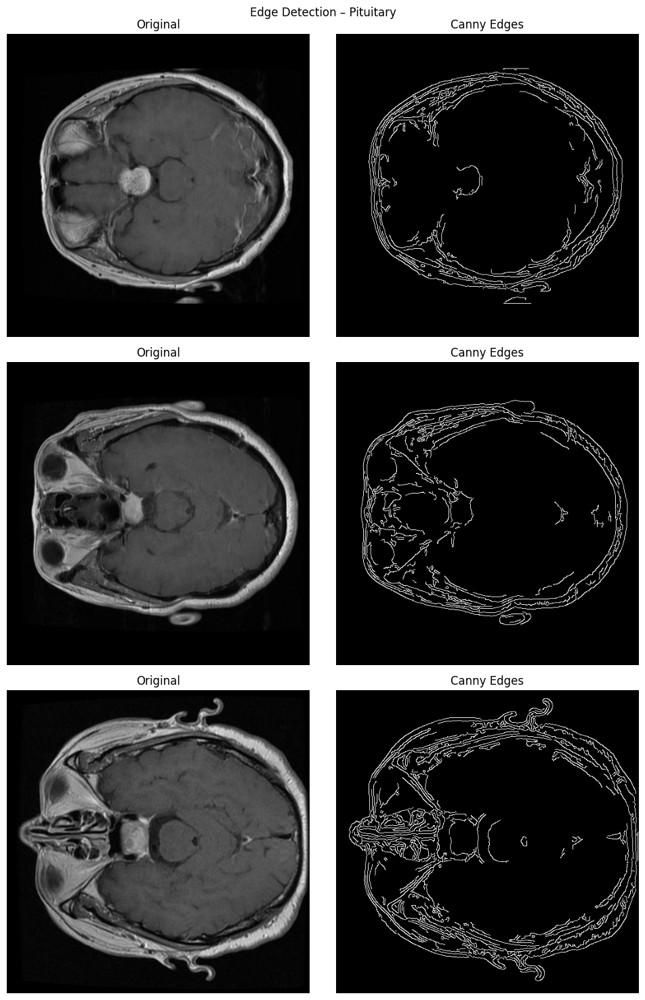


=== Imbalanced_Data001 – Augmentation previews ===


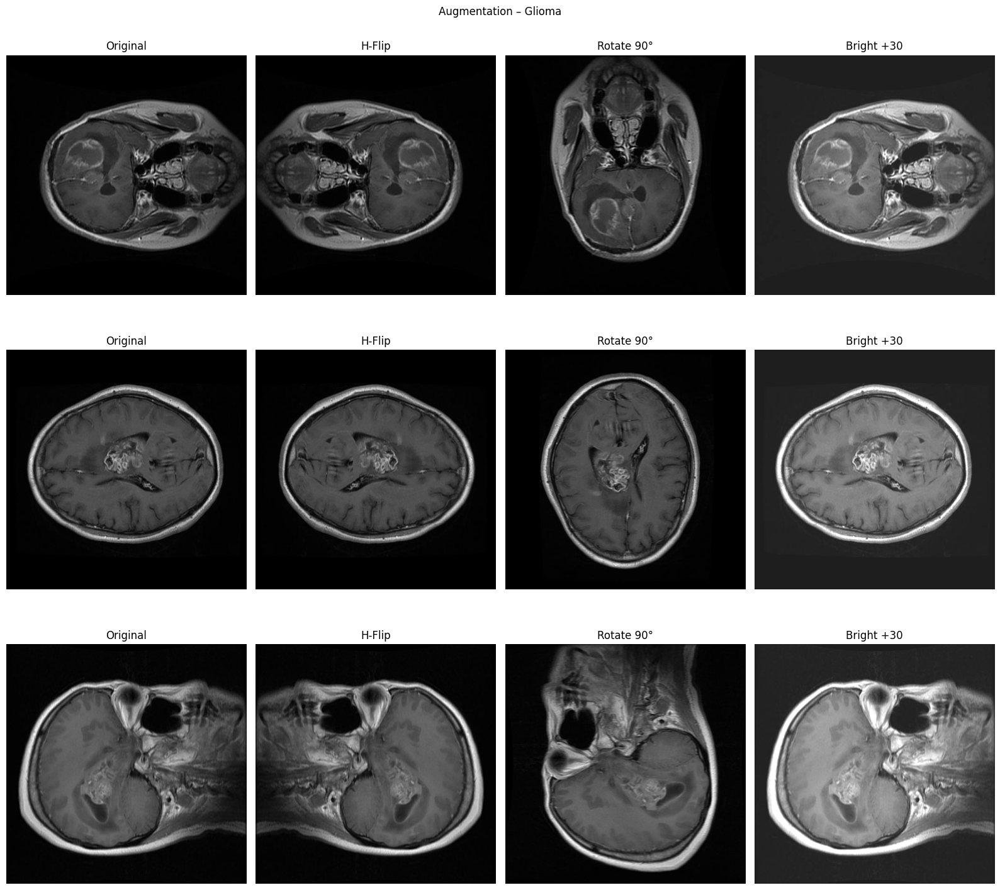

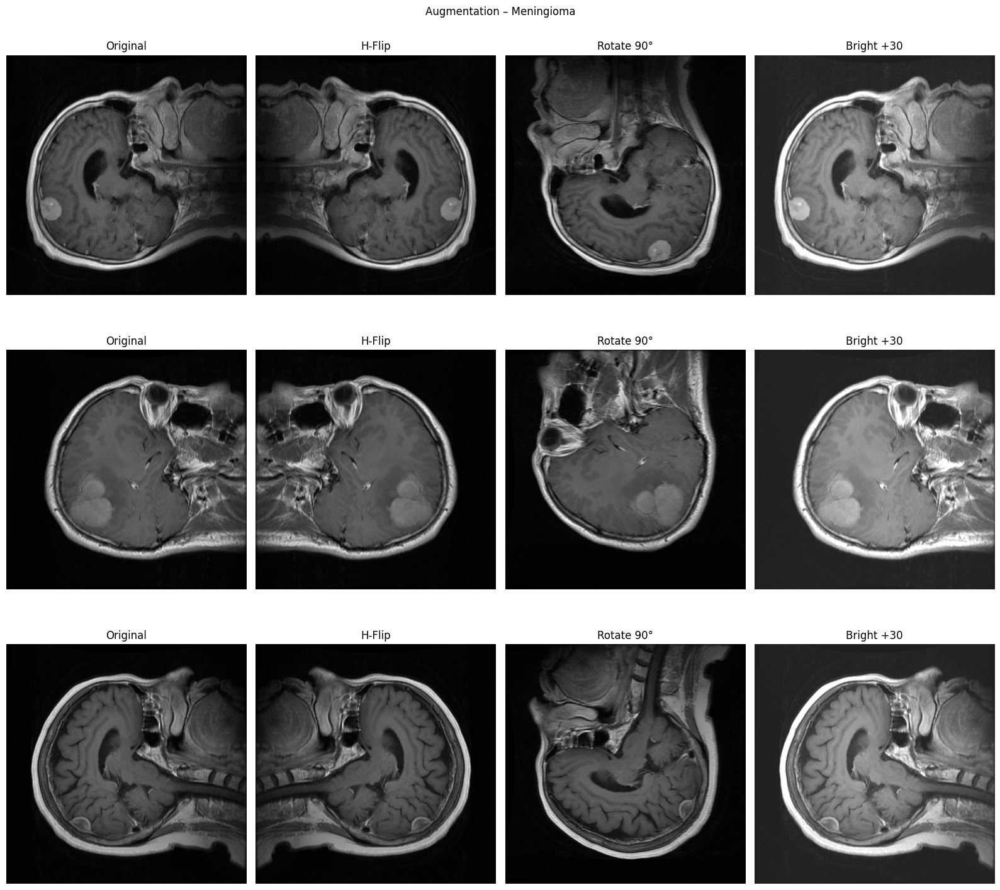

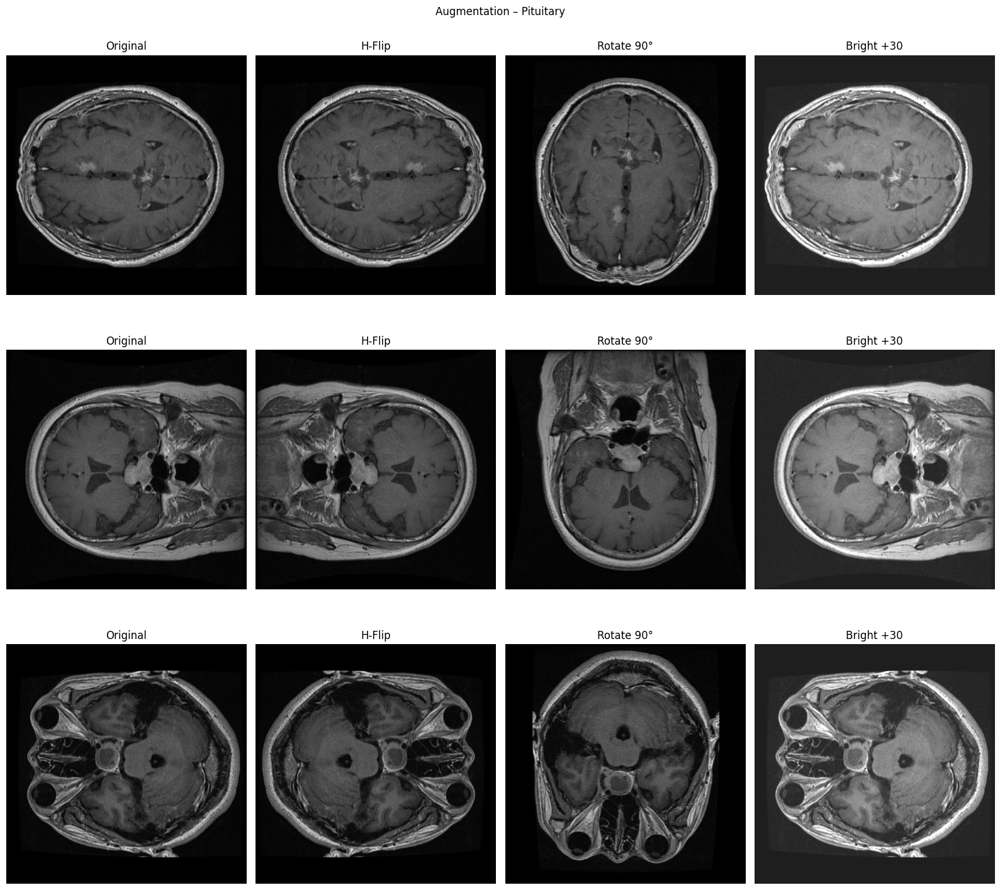


=== Balanced_Data001 – Augmentation previews ===


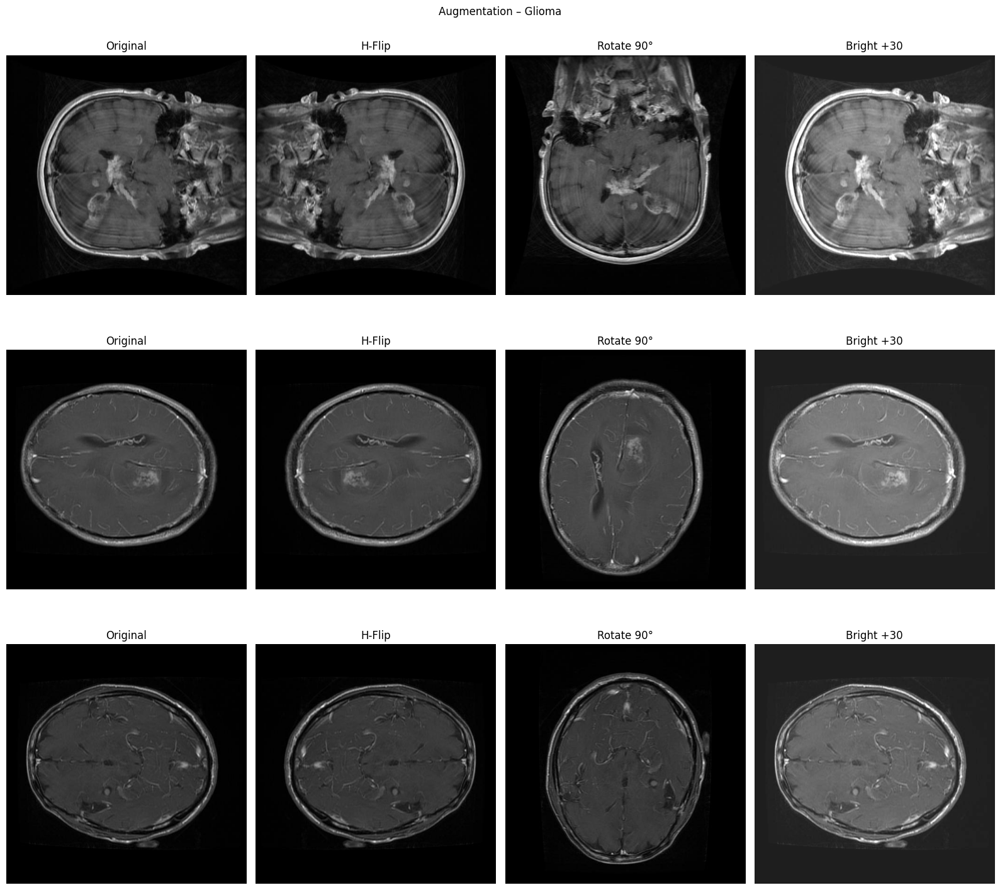

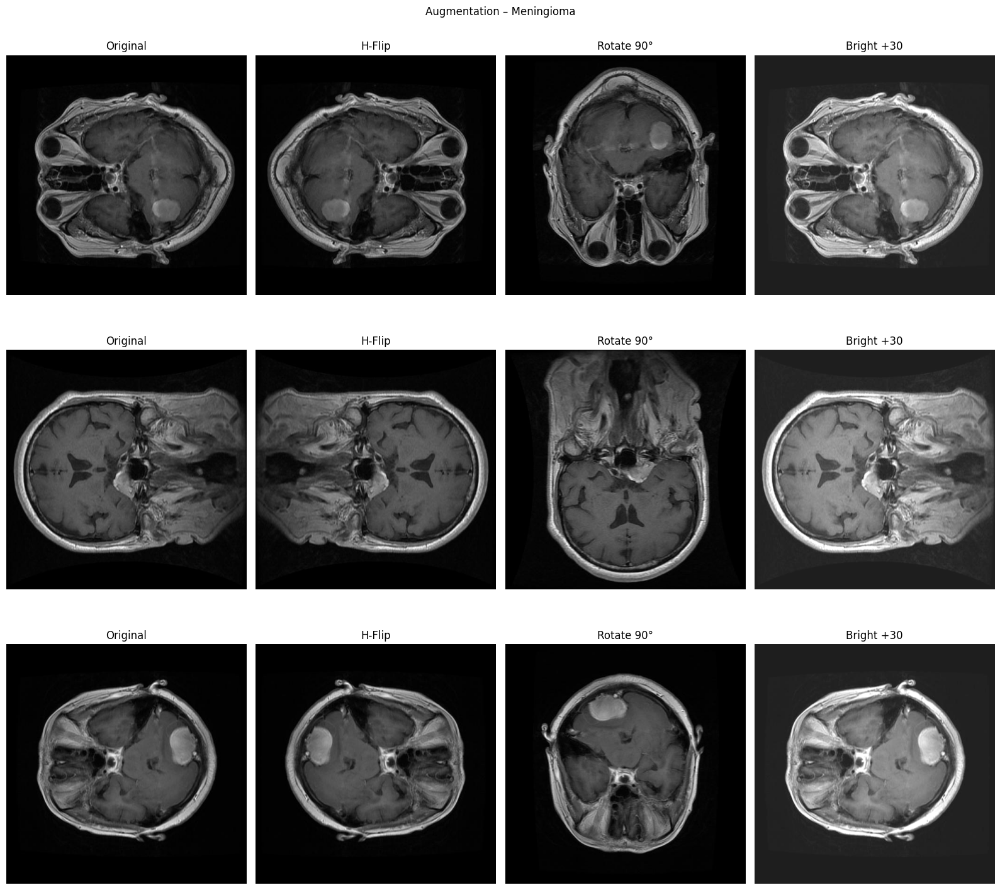

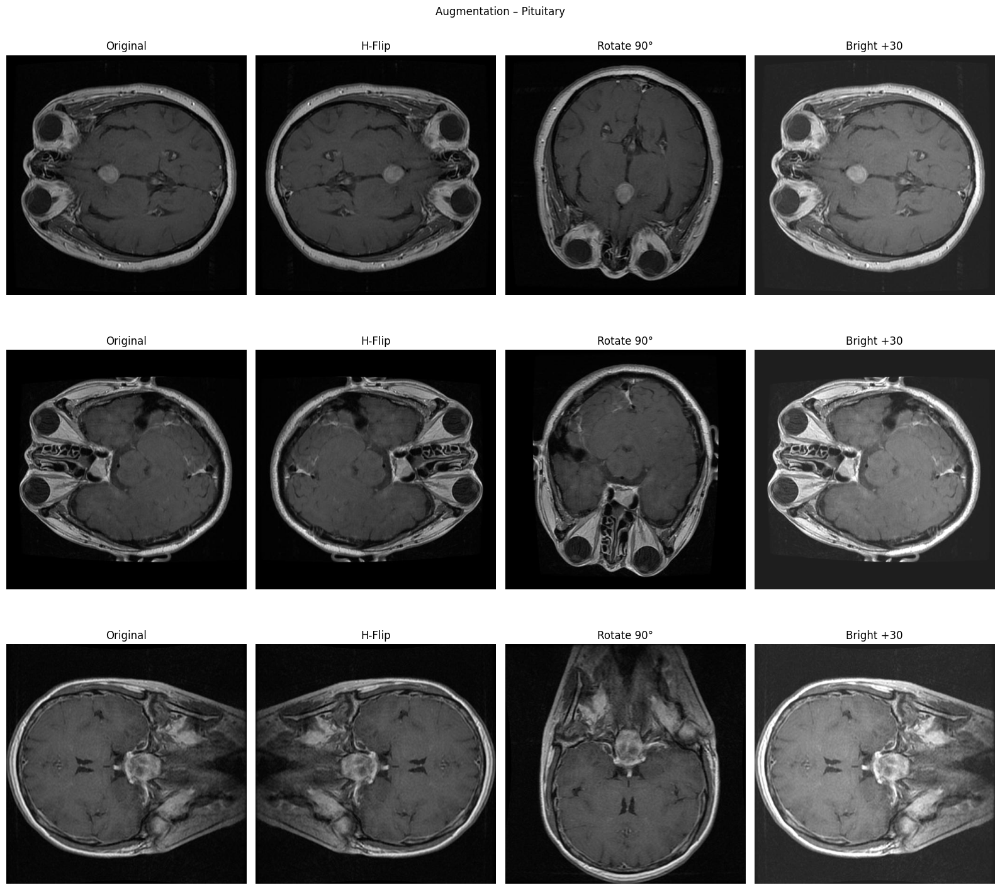

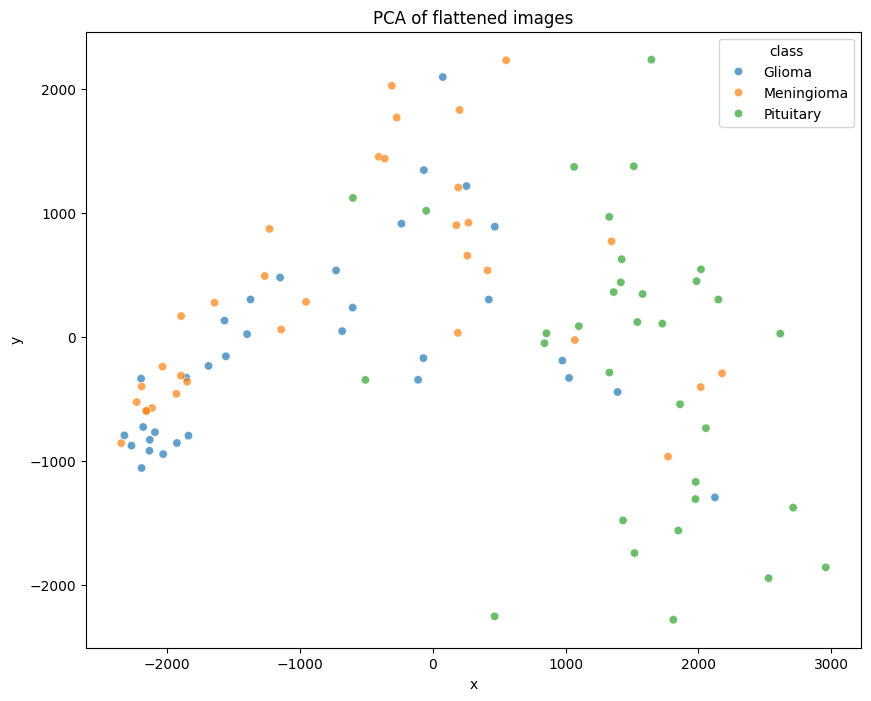

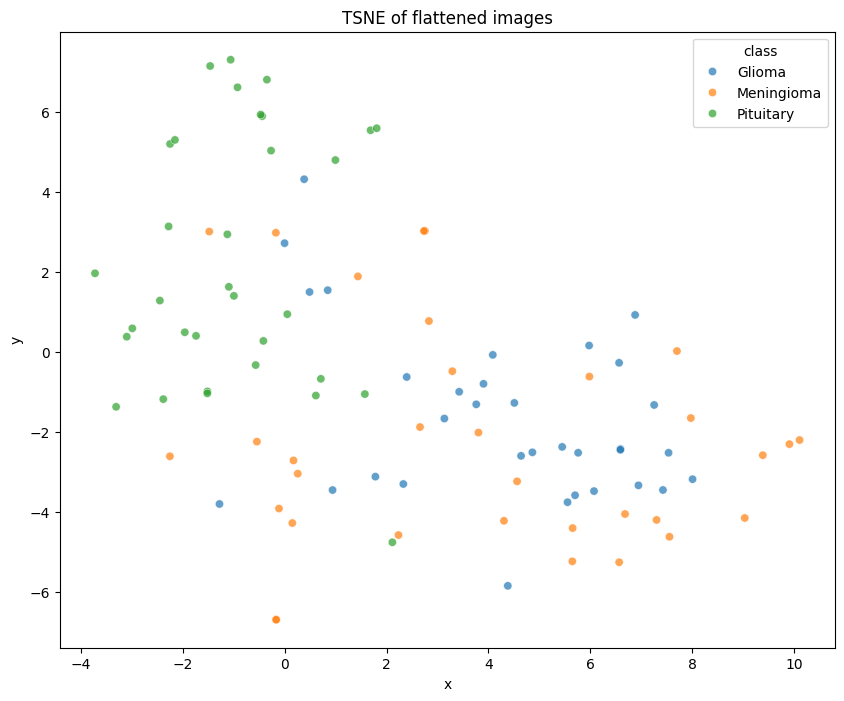

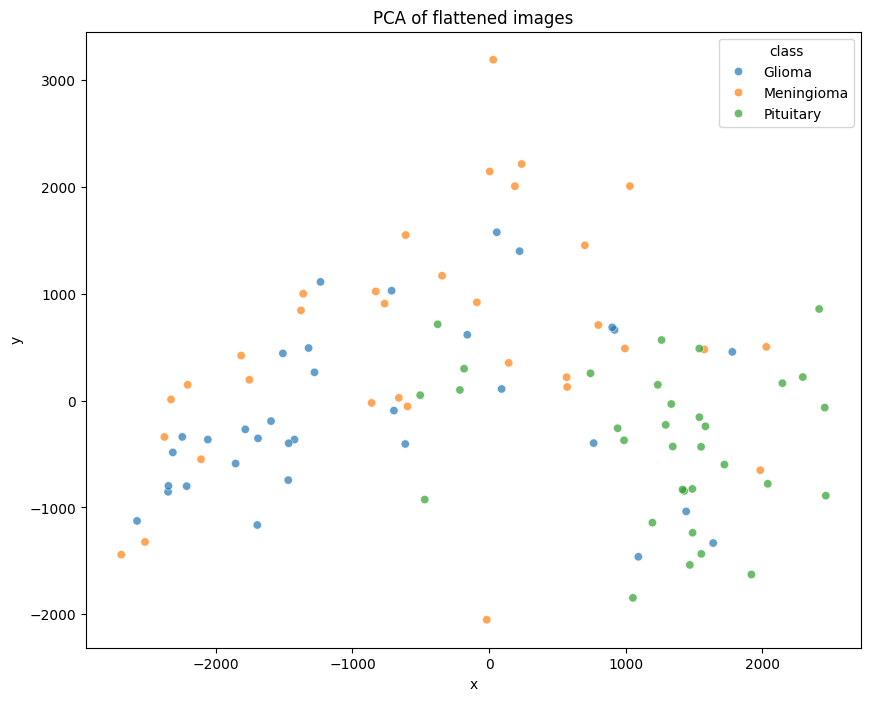

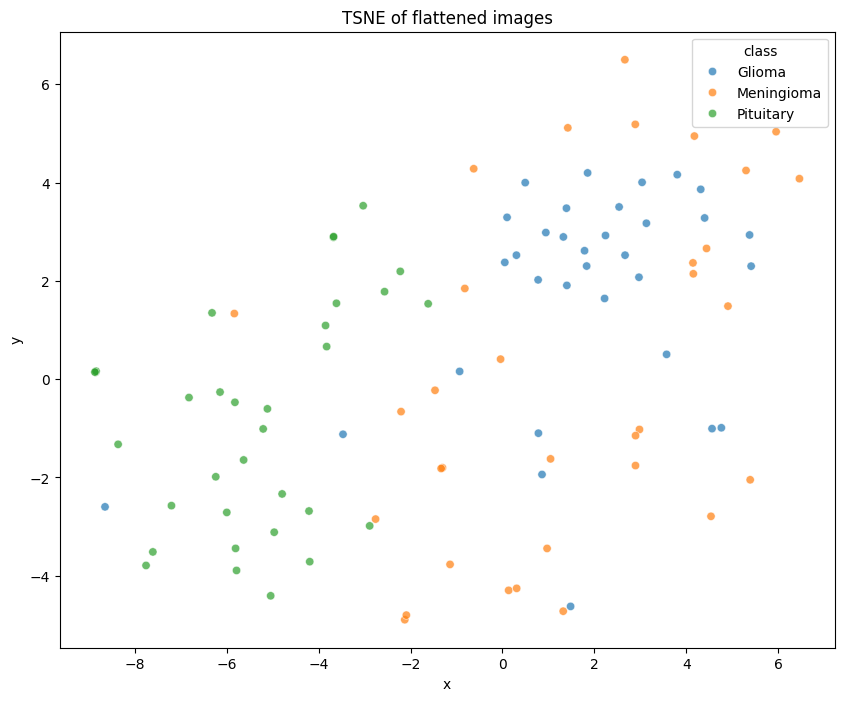

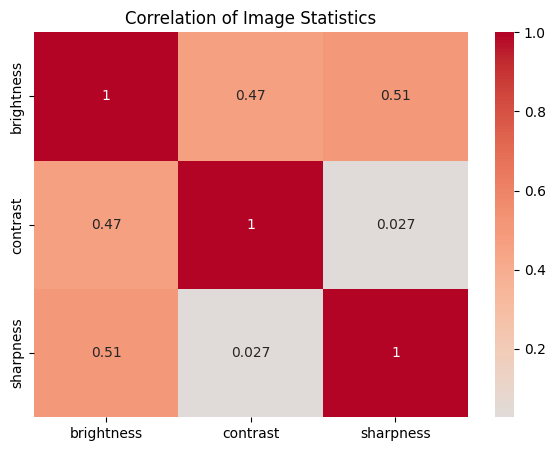


=== Imbalanced_Data001 – Correlation ===


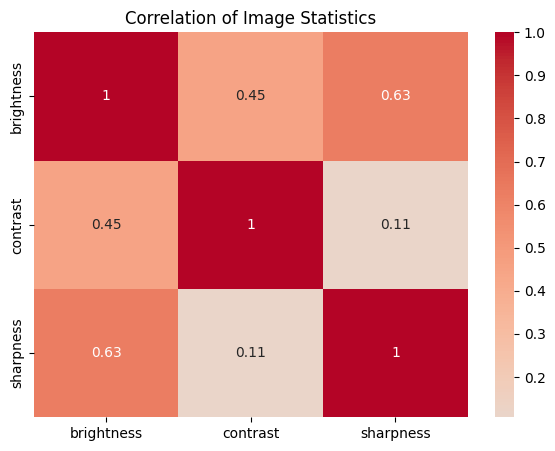


=== Balanced_Data001 – Correlation ===


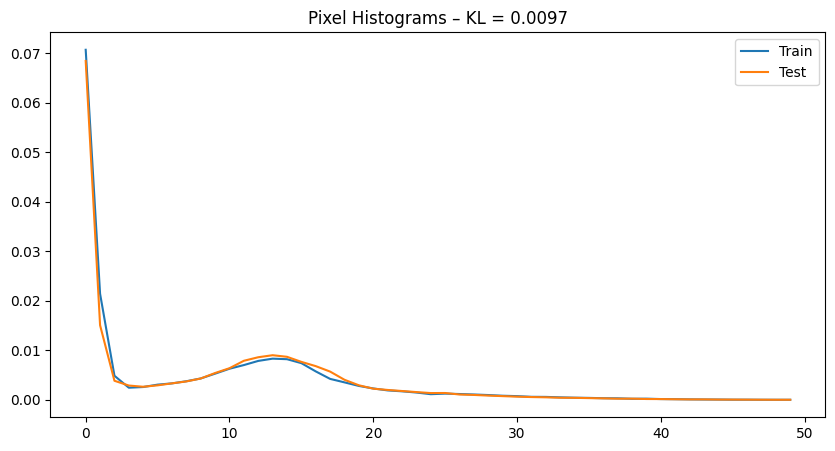

KL-divergence = 0.0097


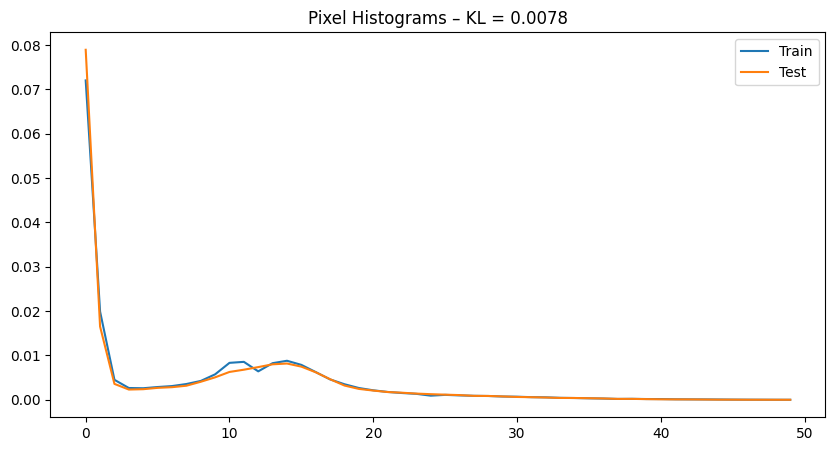

KL-divergence = 0.0078


In [6]:

def file_metadata_check(directory, sample_size=100):
    """Collect size, format, timestamp for a random sample."""
    metadata = []
    all_files = []
    for cls in get_all_classes(directory):
        cls_path = os.path.join(directory, cls)
        files = [f for f in os.listdir(cls_path)
                 if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:sample_size]
        all_files.extend([os.path.join(cls_path, f) for f in files])

    random.shuffle(all_files)
    sample_files = all_files[:sample_size]

    for fp in sample_files:
        try:
            size = os.path.getsize(fp)
            mtime = os.path.getmtime(fp)
            with Image.open(fp) as img:
                fmt = img.format
            metadata.append({
                'file': os.path.basename(fp),
                'size_bytes': size,
                'format': fmt,
                'timestamp': pd.to_datetime(mtime, unit='s')
            })
        except Exception as e:
            print(f"Error {fp}: {e}")
    return pd.DataFrame(metadata)


def show_one_image_per_class(directory):
    """One random image per class in a single row."""
    classes = get_all_classes(directory)
    n = len(classes)
    plt.figure(figsize=(5 * n, 5))

    for i, cls in enumerate(classes):
        cls_path = os.path.join(directory, cls)
        img_name = random.choice([f for f in os.listdir(cls_path)
                                 if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
        img = cv2.imread(os.path.join(cls_path, img_name))[:, :, ::-1]

        plt.subplot(1, n, i + 1)
        plt.imshow(img)
        plt.title(cls, fontsize=18)
        plt.axis('off')

    plt.tight_layout()
    plt.show()


def interactive_image_browser(directory, n_samples=20):
    """Plotly scatter – click a point → see the thumbnail (requires Plotly)."""
    samples = []
    classes = get_all_classes(directory)

    per_class = max(1, n_samples // len(classes))
    for cls in classes:
        cls_path = os.path.join(directory, cls)
        imgs = [f for f in os.listdir(cls_path)
                if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:per_class]
        for f in imgs:
            fp = os.path.join(cls_path, f)
            img = cv2.imread(fp)
            if img is not None:
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img_rgb = cv2.resize(img_rgb, (128, 128))
                samples.append({
                    'class': cls,
                    'file': f,
                    'img': img_rgb
                })

    df = pd.DataFrame(samples)
    # Plotly needs a string representation of the image
    df['img_str'] = df['img'].apply(lambda x: f'<img src="data:image/png;base64,{cv2.imencode(".png", cv2.cvtColor(x, cv2.COLOR_RGB2BGR))[1].tobytes().hex()}">')
    fig = px.scatter(df, x='class', y='file', color='class',
                     hover_data=['img_str'],
                     title="Interactive Image Browser")
    fig.update_traces(marker=dict(size=12))
    fig.show()


def before_after_preprocessing(directory, class_name, n=3, resize_shape=(224, 224)):
    """Original vs. resized+normalized for *one* class."""
    cls_path = os.path.join(directory, class_name)
    imgs = [f for f in os.listdir(cls_path)
            if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:n]
    fig, axs = plt.subplots(n, 2, figsize=(10, 5 * n))

    for i, f in enumerate(imgs):
        fp = os.path.join(cls_path, f)
        orig = cv2.imread(fp)
        orig_rgb = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)

        # preprocess
        resized = cv2.resize(orig, resize_shape)
        norm = resized / 255.0

        axs[i, 0].imshow(orig_rgb)
        axs[i, 0].set_title(f"Original – {f}")
        axs[i, 0].axis('off')

        axs[i, 1].imshow(norm)
        axs[i, 1].set_title("Resized & Normalized")
        axs[i, 1].axis('off')

    plt.suptitle(f"Before / After – {class_name}")
    plt.tight_layout()
    plt.show()


def plot_pixel_histograms(directory, sample_size=20, resize_shape=(64, 64)):
    """RGB histograms (averaged over all classes)."""
    pixels = {'R': [], 'G': [], 'B': []}
    for cls in get_all_classes(directory):
        cls_path = os.path.join(directory, cls)
        imgs = random.sample([f for f in os.listdir(cls_path)
                              if f.lower().endswith(('.png', '.jpg', '.jpeg'))],
                             min(sample_size, 100))
        for f in imgs:
            img = cv2.imread(os.path.join(cls_path, f))
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, resize_shape)
                for c, ch in enumerate(['R', 'G', 'B']):
                    pixels[ch].extend(img[:, :, c].ravel())

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    for ax, (ch, col) in zip(axs, [('R', 'red'), ('G', 'green'), ('B', 'blue')]):
        ax.hist(pixels[ch], bins=50, color=col, alpha=0.7, density=True)
        ax.set_title(f'{ch} Channel')
        ax.set_xlabel('Intensity')
    plt.suptitle('Pixel Intensity Histograms (RGB)')
    plt.tight_layout()
    plt.show()


def plot_hsv_histograms(directory, sample_size=20, resize_shape=(64, 64)):
    """HSV histograms (averaged)."""
    hsv = {'H': [], 'S': [], 'V': []}
    for cls in get_all_classes(directory):
        cls_path = os.path.join(directory, cls)
        imgs = random.sample([f for f in os.listdir(cls_path)
                              if f.lower().endswith(('.png', '.jpg', '.jpeg'))],
                             min(sample_size, 100))
        for f in imgs:
            img = cv2.imread(os.path.join(cls_path, f))
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, resize_shape)
                img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
                hsv['H'].extend(img_hsv[:, :, 0].ravel())      # 0-179
                hsv['S'].extend(img_hsv[:, :, 1].ravel() / 255) # 0-1
                hsv['V'].extend(img_hsv[:, :, 2].ravel() / 255) # 0-1

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    for ax, (ch, col) in zip(axs, [('H', 'orange'), ('S', 'magenta'), ('V', 'yellow')]):
        data = hsv[ch]
        if ch == 'H':
            data = np.array(data) * 2          # roughly to 0-360 degrees
        ax.hist(data, bins=50, color=col, alpha=0.7, density=True)
        ax.set_title(f'{ch} Channel')
    plt.suptitle('HSV Histograms')
    plt.tight_layout()
    plt.show()


def compute_blurriness(directory, sample_size=50, resize_shape=(128, 128)):
    """Laplacian variance → sharpness."""
    variances = []
    for cls in get_all_classes(directory):
        cls_path = os.path.join(directory, cls)
        imgs = random.sample([f for f in os.listdir(cls_path)
                              if f.lower().endswith(('.png', '.jpg', '.jpeg'))],
                             min(sample_size, 100))
        for f in imgs:
            img = cv2.imread(os.path.join(cls_path, f), cv2.IMREAD_GRAYSCALE)
            if img is not None:
                img = cv2.resize(img, resize_shape)
                variances.append(cv2.Laplacian(img, cv2.CV_64F).var())

    plt.figure(figsize=(8, 5))
    plt.hist(variances, bins=30, color='purple', alpha=0.7)
    plt.axvline(np.mean(variances), color='red', linestyle='--',
                label=f'Mean {np.mean(variances):.2f}')
    plt.title('Sharpness Distribution')
    plt.xlabel('Laplacian Variance')
    plt.legend()
    plt.show()
    return np.mean(variances), np.std(variances)


def edge_detection_overlays(directory, class_name, n=3):
    """Canny edges + original."""
    cls_path = os.path.join(directory, class_name)
    imgs = random.sample([f for f in os.listdir(cls_path)
                          if f.lower().endswith(('.png', '.jpg', '.jpeg'))], n)
    fig, axs = plt.subplots(n, 2, figsize=(10, 5 * n))
    for i, f in enumerate(imgs):
        fp = os.path.join(cls_path, f)
        orig = cv2.imread(fp)
        gray = cv2.cvtColor(orig, cv2.COLOR_BGR2GRAY)
        edges = cv2.Canny(gray, 100, 200)

        axs[i, 0].imshow(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
        axs[i, 0].set_title('Original')
        axs[i, 0].axis('off')

        axs[i, 1].imshow(edges, cmap='gray')
        axs[i, 1].set_title('Canny Edges')
        axs[i, 1].axis('off')
    plt.suptitle(f'Edge Detection – {class_name}')
    plt.tight_layout()
    plt.show()


def augmentation_previews(directory, class_name, n=3):
    """Flip / Rotate / Brightness for one class."""
    cls_path = os.path.join(directory, class_name)
    imgs = random.sample([f for f in os.listdir(cls_path)
                          if f.lower().endswith(('.png', '.jpg', '.jpeg'))], n)
    fig, axs = plt.subplots(n, 4, figsize=(16, 5 * n))
    for i, f in enumerate(imgs):
        fp = os.path.join(cls_path, f)
        orig = cv2.imread(fp)
        rgb = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)

        flip = cv2.flip(orig, 1)
        flip_rgb = cv2.cvtColor(flip, cv2.COLOR_BGR2RGB)

        h, w = orig.shape[:2]
        M = cv2.getRotationMatrix2D((w/2, h/2), 90, 1)
        rot = cv2.warpAffine(orig, M, (w, h))
        rot_rgb = cv2.cvtColor(rot, cv2.COLOR_BGR2RGB)

        bright = cv2.convertScaleAbs(orig, alpha=1.3, beta=30)
        bright_rgb = cv2.cvtColor(bright, cv2.COLOR_BGR2RGB)

        for ax, img, title in zip(axs[i],
                                  [rgb, flip_rgb, rot_rgb, bright_rgb],
                                  ['Original', 'H-Flip', 'Rotate 90°', 'Bright +30']):
            ax.imshow(img)
            ax.set_title(title)
            ax.axis('off')
    plt.suptitle(f'Augmentation – {class_name}')
    plt.tight_layout()
    plt.show()


def pca_tsne_visualization(directory, sample_size=100, method='PCA'):
    """Flatten → PCA / t-SNE → scatter."""
    X, y = [], []
    for cls in get_all_classes(directory):
        cls_path = os.path.join(directory, cls)
        imgs = random.sample([f for f in os.listdir(cls_path)
                              if f.lower().endswith(('.png', '.jpg', '.jpeg'))],
                             min(sample_size // len(get_all_classes(directory)), 100))
        for f in imgs:
            img = cv2.imread(os.path.join(cls_path, f))
            if img is not None:
                img = cv2.resize(img, (64, 64))
                X.append(img.flatten())
                y.append(cls)
    X = np.array(X)

    reducer = PCA(n_components=2) if method == 'PCA' else TSNE(n_components=2, random_state=42)
    X2 = reducer.fit_transform(X)

    df = pd.DataFrame({'x': X2[:, 0], 'y': X2[:, 1], 'class': y})
    plt.figure(figsize=(10, 8))
    sns.scatterplot(data=df, x='x', y='y', hue='class', palette='tab10', alpha=0.7)
    plt.title(f'{method} of flattened images')
    plt.show()


def correlation_matrix_stats(directory, sample_size=50, resize_shape=(128, 128)):
    """Brightness / Contrast / Sharpness correlation."""
    stats = []
    for cls in get_all_classes(directory):
        cls_path = os.path.join(directory, cls)
        imgs = random.sample([f for f in os.listdir(cls_path)
                              if f.lower().endswith(('.png', '.jpg', '.jpeg'))],
                             min(sample_size, 100))
        for f in imgs:
            img = cv2.imread(os.path.join(cls_path, f))
            if img is not None:
                img = cv2.resize(img, resize_shape)
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                stats.append([
                    np.mean(gray),          # brightness
                    np.std(gray),           # contrast
                    cv2.Laplacian(gray, cv2.CV_64F).var()  # sharpness
                ])
    df = pd.DataFrame(stats, columns=['brightness', 'contrast', 'sharpness'])
    corr = df.corr()
    plt.figure(figsize=(7, 5))
    sns.heatmap(corr, annot=True, cmap='coolwarm', center=0)
    plt.title('Correlation of Image Statistics')
    plt.show()
    return corr


def subset_distribution_shift(train_dir, test_dir, sample_size=20, resize_shape=(64, 64)):
    """Pixel-histogram KL-divergence train vs. test."""
    def hist(dir_):
        pixels = []
        for cls in get_all_classes(dir_):
            cls_path = os.path.join(dir_, cls)
            imgs = random.sample([f for f in os.listdir(cls_path)
                                  if f.lower().endswith(('.png', '.jpg', '.jpeg'))],
                                 min(sample_size, 100))
            for f in imgs:
                img = cv2.imread(os.path.join(cls_path, f), cv2.IMREAD_GRAYSCALE)
                if img is not None:
                    img = cv2.resize(img, resize_shape)
                    pixels.extend(img.ravel())
        h, _ = np.histogram(pixels, bins=50, density=True)
        return h + 1e-10

    h_train = hist(train_dir)
    h_test  = hist(test_dir)
    kl = entropy(h_train, h_test)

    plt.figure(figsize=(10, 5))
    plt.plot(h_train, label='Train')
    plt.plot(h_test,  label='Test')
    plt.title(f'Pixel Histograms – KL = {kl:.4f}')
    plt.legend()
    plt.show()
    print(f'KL-divergence = {kl:.4f}')
    


imbalanced = "Imbalanced_Data001"
balanced   = "Balanced_Data001"

for name in [imbalanced, balanced]:
    print(f"\n=== {name} – Metadata ===")
    df = file_metadata_check(datasets[name]["train"])
    display(df.head())
    print("Formats:", df['format'].unique())
    print(f"Avg size: {df['size_bytes'].mean():.0f} bytes")

for name in [imbalanced, balanced]:
    print(f"\n=== {name} – One image per class ===")
    show_one_image_per_class(datasets[name]["train"])

for name in [imbalanced, balanced]:
    interactive_image_browser(datasets[name]["train"], n_samples=30)

for name in [imbalanced, balanced]:
    print(f"\n=== {name} – Before/After (per class) ===")
    for cls in get_all_classes(datasets[name]["train"]):
        before_after_preprocessing(datasets[name]["train"], cls, n=3)

for name in [imbalanced, balanced]:
    plot_pixel_histograms(datasets[name]["train"])
    plot_hsv_histograms(datasets[name]["train"])

for name in [imbalanced, balanced]:
    m, s = compute_blurriness(datasets[name]["train"])
    print(f"{name} – Sharpness mean: {m:.2f} ± {s:.2f}")


for name in [imbalanced, balanced]:
    print(f"\n=== {name} – Edge overlays ===")
    for cls in get_all_classes(datasets[name]["train"]):
        edge_detection_overlays(datasets[name]["train"], cls, n=3)
        
for name in [imbalanced, balanced]:
    print(f"\n=== {name} – Augmentation previews ===")
    for cls in get_all_classes(datasets[name]["train"]):
        augmentation_previews(datasets[name]["train"], cls, n=3)

for name in [imbalanced, balanced]:
    pca_tsne_visualization(datasets[name]["train"], method='PCA')
    pca_tsne_visualization(datasets[name]["train"], method='TSNE')

for name in [imbalanced, balanced]:
    corr = correlation_matrix_stats(datasets[name]["train"])
    print(f"\n=== {name} – Correlation ===")

for name in [imbalanced, balanced]:
    subset_distribution_shift(datasets[name]["train"],
                              datasets[name]["test"])

# Data Generator


In [10]:


# Parameters
target_size = (224, 224)
batch_size = 32

# Image augmentation / preprocessing
datagen = ImageDataGenerator(
    rescale=1/255,
    rotation_range=15,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    vertical_flip=True,
    fill_mode='nearest'
)

# Training data generator
train_generator = datagen.flow_from_directory(
    directory=dataset["train"],
    target_size=target_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=True
)

# Testing / validation data generator
test_generator = datagen.flow_from_directory(
    directory=dataset["test"],
    target_size=target_size,
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)


Found 5712 images belonging to 4 classes.
Found 1311 images belonging to 4 classes.


In [11]:
table_data = [
    [
        "Imbalanced_3_Dataset_Combined",
        train_generator.samples,
        test_generator.samples,
        train_generator.samples // batch_size,
        test_generator.samples // batch_size,
    train_generator.num_classes
    ]
]

# Table header
headers = ["Dataset", "Training Samples", "Validation Samples",
           "Steps/Epoch", "Val Steps", "Num Classes"]

# Print table
print(tabulate(table_data, headers=headers, tablefmt="grid"))

+-------------------------------+--------------------+----------------------+---------------+-------------+---------------+
| Dataset                       |   Training Samples |   Validation Samples |   Steps/Epoch |   Val Steps |   Num Classes |
+===============================+====================+======================+===============+=============+===============+
| Imbalanced_3_Dataset_Combined |               5712 |                 1311 |           178 |          40 |             4 |
+-------------------------------+--------------------+----------------------+---------------+-------------+---------------+


# Model Architechtutre

## Clean Model Naming

In [23]:
import re

def sanitize_layer_names(model):
    """Clean all layer names inside a model so TF can load it safely."""
    def clean(name):
        return re.sub(r'[^A-Za-z0-9_]+', '_', name)

    # Fix model name
    model._name = clean(model.name)

    for layer in model.layers:
        old = layer.name
        layer._name = clean(layer.name)

        # Fix config name if present
        if hasattr(layer, '_config') and isinstance(layer._config, dict):
            if "name" in layer._config:
                layer._config["name"] = clean(layer._config["name"])

        # Fix nested models
        if isinstance(layer, Model):
            sanitize_layer_names(layer)

    return model

## Channel Block Attention 

In [24]:
def cbam_block(input_feature, ratio=8, kernel_size=7, name=None):
    """ Convolutional Block Attention Module """
    channel = K.int_shape(input_feature)[-1]
    if channel is None:
        raise ValueError("cbam_block requires a statically-known channel dimension")

    avg_pool = layers.GlobalAveragePooling2D()(input_feature)
    max_pool = layers.GlobalMaxPooling2D()(input_feature)
    shared_dense_one = layers.Dense(channel // ratio, activation='relu', use_bias=False)
    shared_dense_two = layers.Dense(channel, use_bias=False)
    avg_out = shared_dense_two(shared_dense_one(avg_pool))
    max_out = shared_dense_two(shared_dense_one(max_pool))
    channel_attention = layers.Add()([avg_out, max_out])
    channel_attention = layers.Activation('sigmoid')(channel_attention)
    channel_attention = layers.Reshape((1, 1, channel))(channel_attention)
    x = layers.Multiply()([input_feature, channel_attention])

    avg_spatial = tf.reduce_mean(x, axis=-1, keepdims=True)
    max_spatial = tf.reduce_max(x, axis=-1, keepdims=True)
    spatial = layers.Concatenate(axis=-1)([avg_spatial, max_spatial])
    spatial_attention = layers.Conv2D(1, kernel_size, padding='same', activation='sigmoid')(spatial)
    x = layers.Multiply()([x, spatial_attention])

    if name:
        x = layers.Lambda(lambda z: z, name=name)(x)
    return x

## Model Architecture


In [ ]:

def build_dual_branch_cbam_gradcam(
    num_classes=,
    input_shape=(224, 224, 3),
    dense_units=512,
    dropout_rate=0.2,
    learning_rate=0.002,
    optimizer="nadam",
    model_name="Hybrid_MobDenseNet_CBAM_GradCAM",
    freeze_pretrained=True
):
    inp = Input(shape=input_shape)
    
    base_a = applications.MobileNetV2(include_top=False, weights='imagenet', input_tensor=inp, alpha=0.75)
    if freeze_pretrained:
        for layer in base_a.layers:
            layer.trainable = False
    feat_a = base_a.output
    cbam_a = cbam_block(feat_a, ratio=16, name="cbam_mobilenet")

    base_b = applications.DenseNet121(include_top=False, weights='imagenet', input_tensor=inp)
    if freeze_pretrained:
        for layer in base_b.layers:
            layer.trainable = False
    feat_b = base_b.output
    cbam_b = cbam_block(feat_b, ratio=16, name="cbam_densenet")

    merged = layers.Concatenate(axis=-1, name="concat_features")([cbam_a, cbam_b])

    attentioned = cbam_block(merged, ratio=16, name="cbam_attention")
    gradcam_layer = layers.Conv2D(256, 1, activation='relu', name="additional_gradcam_layer")(attentioned)

    gap = layers.GlobalAveragePooling2D()(gradcam_layer)
    x = layers.BatchNormalization()(gap)
    x = layers.Dense(dense_units, activation='swish')(x)
    x = layers.Dropout(dropout_rate)(x)
    output = layers.Dense(num_classes, activation='softmax', name='predictions')(x)

    model = Model(inputs=inp, outputs=output, name=model_name)

    opt = optimizer.lower()
    if opt == "nadam":
        opt_inst = tf.keras.optimizers.Nadam(learning_rate=learning_rate)
    elif opt == "adam":
        opt_inst = tf.keras.optimizers.Adam(learning_rate=learning_rate)
    elif opt == "sgd":
        opt_inst = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9)
    else:
        opt_inst = tf.keras.optimizers.get({"class_name": optimizer, "config": {"learning_rate": learning_rate}})

    model.compile(optimizer=opt_inst, loss="categorical_crossentropy", metrics=["accuracy"])
    
    return model

In [26]:
model = build_dual_branch_cbam_gradcam(
    num_classes=4,
    input_shape=(224, 224, 3),
    dense_units=512,
    dropout_rate=0.2,
    learning_rate=0.002,
    optimizer="nadam",
    model_name="Hybrid_MobDenseNet_CBAM_GradCAM"
)

model = sanitize_layer_names(model)

print(f"\nModel '{model.name}' built and sanitized successfully!")

def get_last_conv_layer(model):
    for layer in reversed(model.layers):
        if isinstance(layer, layers.Conv2D):
            return layer.name
    raise ValueError("No Conv2D layer found!")

last_conv_name = get_last_conv_layer(model)
print(f"Last Conv2D layer (for Grad-CAM): '{last_conv_name}'")


Model 'Hybrid_MobDenseNet_CBAM_GradCAM' built and sanitized successfully!
Last Conv2D layer (for Grad-CAM): 'additional_gradcam_layer'


## Train Function

In [27]:
output_dir = r"E:\models\Combine3_dataset\Imbalance\FinalModel"
checkpoint_dir = r"E:\models\Combine3_dataset\Imbalance\checkpoints"

os.makedirs(output_dir, exist_ok=True)
os.makedirs(checkpoint_dir, exist_ok=True)

callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True),
    tf.keras.callbacks.ModelCheckpoint(filepath=os.path.join(checkpoint_dir,f'{model.name}.h5'), monitor='val_loss', save_best_only=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=15, min_lr=1e-6),
    tf.keras.callbacks.CSVLogger(os.path.join(output_dir, f'{model.name}_training_log.csv'))
]

history_balanced = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    validation_data=test_generator,
    validation_steps=test_generator.samples // batch_size,
    epochs=EPOCHS_INITIAL,
    callbacks=callbacks
)

final_model_path = os.path.join(output_dir, f'{model.name}.h5')
model.save(final_model_path)

print(f"Model saved at: {final_model_path}")


Epoch 1/80
178/178 [==============================] - 390s 2s/step - loss: 0.4230 - accuracy: 0.8460 - val_loss: 0.3718 - val_accuracy: 0.8641 - lr: 0.0020
Epoch 2/80
178/178 [==============================] - 156s 875ms/step - loss: 0.2971 - accuracy: 0.8940 - val_loss: 0.4784 - val_accuracy: 0.8273 - lr: 0.0020
Epoch 3/80
178/178 [==============================] - 160s 901ms/step - loss: 0.2342 - accuracy: 0.9146 - val_loss: 0.2571 - val_accuracy: 0.8992 - lr: 0.0020
Epoch 4/80
178/178 [==============================] - 184s 1s/step - loss: 0.2219 - accuracy: 0.9173 - val_loss: 0.2940 - val_accuracy: 0.8875 - lr: 0.0020
Epoch 5/80
178/178 [==============================] - 176s 988ms/step - loss: 0.1962 - accuracy: 0.9261 - val_loss: 0.2359 - val_accuracy: 0.9070 - lr: 0.0020
Epoch 6/80
178/178 [==============================] - 200s 1s/step - loss: 0.2017 - accuracy: 0.9271 - val_loss: 0.2686 - val_accuracy: 0.8938 - lr: 0.0020
Epoch 7/80
178/178 [==============================] - 2

In [28]:
import pandas as pd
import os

# Create a DataFrame from the training history
history_df = pd.DataFrame(history_balanced.history)

# Path where you want to save the CSV
save_path = r"E:\models\Combine3_dataset\Imbalance\training_history_final.csv"

# Make sure directory exists (optional but recommended)
os.makedirs(os.path.dirname(save_path), exist_ok=True)

# Save the CSV
history_df.to_csv(save_path, index=False)

print(f"Training history saved to: {save_path}")



Training history saved to: E:\models\Combine3_dataset\Imbalance\training_history_final.csv


In [29]:
# ================================================
# 2. STRONG & FAST GRAD-CAM
# ================================================
def get_strong_gradcam_heatmap(model, img_array, layer_name="additional_gradcam_layer"):
    grad_model = tf.keras.models.Model(
        inputs=model.input,
        outputs=[model.get_layer(layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array, training=False)
        pred_idx = tf.argmax(predictions[0])
        loss = predictions[:, pred_idx]

    grads = tape.gradient(loss, conv_outputs)
    if grads is None:
        grads = tf.zeros_like(conv_outputs)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]

    heatmap = tf.reduce_sum(tf.nn.relu(conv_outputs * pooled_grads), axis=-1)
    if tf.reduce_max(heatmap) > 0:
        heatmap /= tf.reduce_max(heatmap)

    heatmap = np.uint8(255 * heatmap.numpy())
    heatmap = cv2.resize(heatmap, (224, 224), interpolation=cv2.INTER_CUBIC)
    heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    return heatmap_colored, int(pred_idx), predictions.numpy()[0]


def overlay_gradcam(img_path, heatmap, alpha=0.45):
    orig = cv2.imread(img_path)
    if orig is None:
        raise ValueError(f"Image not found: {img_path}")
    orig = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)
    orig = cv2.resize(orig, (224, 224))
    overlay = cv2.addWeighted(orig, 0.6, heatmap, alpha, 0)
    return orig, overlay


# ================================================
# 3. FINAL PUBLICATION-READY FUNCTION (100% CORRECT)
# ================================================
def save_complete_artifacts(
    model,
    history_balanced,
    balance_test_gen,
    output_dir,
    model_name = "Hybrid_MobDenseNet_CBAM_GradCAM",
    model_name_with_size="Hybrid_MobDenseNet_CBAM_GradCAM 224x224",
    dataset_name="Brain Tumor MRI (Balanced)",
    class_names=['Glioma', 'Meningioma', 'Pituitary', 'No-Tumor'],
    gradcam_samples=12,
    gradcam_layer_name="additional_gradcam_layer"
):
    os.makedirs(output_dir, exist_ok=True)
    gradcam_dir = os.path.join(output_dir, "GradCAM_Samples")
    os.makedirs(gradcam_dir, exist_ok=True)

    csv_summary  = os.path.join(output_dir, "results_summary.csv")
    csv_detailed = os.path.join(output_dir, "results_detailed.csv")
    csv_paper    = os.path.join(output_dir, "paper_comparison_table.csv")

    # ENSURE shuffle=False and reset
    balance_test_gen.shuffle = False
    balance_test_gen.reset()

    print("Evaluating model on test set...")
    test_loss, test_acc = model.evaluate(balance_test_gen, verbose=0)
    y_proba = model.predict(balance_test_gen, verbose=0)
    y_pred = np.argmax(y_proba, axis=1)
    y_true = balance_test_gen.classes  # Now 100% correct because shuffle=False

    # Metrics
    precision_macro = precision_score(y_true, y_pred, average='macro')
    recall_macro    = recall_score(y_true, y_pred, average='macro')
    f1_macro        = f1_score(y_true, y_pred, average='macro')

    try:
        y_true_bin = tf.keras.utils.to_categorical(y_true, num_classes=len(class_names))
        auc_macro = roc_auc_score(y_true_bin, y_proba, average='macro', multi_class='ovr')
    except Exception as e:
        print("AUC calculation failed:", e)
        auc_macro = "N/A"

    # Inference time (per image)
    dummy = next(balance_test_gen)[0][:8]
    for _ in range(10): model.predict(dummy, verbose=0)
    start = time.time()
    for _ in range(100): model.predict(dummy, verbose=0)
    inference_ms = (time.time() - start) / (100 * len(dummy)) * 1000

    total_params = model.count_params()

    # 1. Training Curves
    plt.figure(figsize=(14, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history_balanced.history['accuracy'], label='Train', linewidth=3, color='#1f77b4')
    plt.plot(history_balanced.history['val_accuracy'], label='Validation', linewidth=3, color='#ff7f0e')
    plt.title('Model Accuracy', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch'); plt.ylabel('Accuracy'); plt.legend(); plt.grid(alpha=0.3)

    plt.subplot(1, 2, 2)
    plt.plot(history_balanced.history['loss'], label='Train', linewidth=3, color='#1f77b4')
    plt.plot(history_balanced.history['val_loss'], label='Validation', linewidth=3, color='#ff7f0e')
    plt.title('Model Loss', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch'); plt.ylabel('Loss'); plt.legend(); plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{model_name}_training_curves.png"), dpi=400, bbox_inches='tight')
    plt.close()

    # 2. Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(9, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names,
                linewidths=1, linecolor='black', cbar_kws={'shrink': 0.8})
    plt.title('Confusion Matrix', fontsize=18, fontweight='bold', pad=20)
    plt.xlabel('Predicted'); plt.ylabel('True')
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{model_name}_confusion_matrix.png"), dpi=400, bbox_inches='tight')
    plt.close()

    # 3. ROC Curves
    y_true_bin = label_binarize(y_true, classes=range(len(class_names)))
    plt.figure(figsize=(10, 8))
    for i, cls in enumerate(class_names):
        fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_proba[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.4f})', linewidth=2.5)
    fpr_micro, tpr_micro, _ = roc_curve(y_true_bin.ravel(), y_proba.ravel())
    plt.plot(fpr_micro, tpr_micro, label=f'Micro-average (AUC = {auc(fpr_micro, tpr_micro):.4f})',
             linestyle='--', linewidth=3, color='deeppink')
    plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
    plt.xlim([0.0, 1.0]); plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate'); plt.ylabel('True Positive Rate')
    plt.title('ROC Curves (One-vs-Rest)', fontsize=16, fontweight='bold')
    plt.legend(loc="lower right"); plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{model_name}_roc_curves.png"), dpi=400, bbox_inches='tight')
    plt.close()

    # 4. FAST Grad-CAM Gallery (loads all images once)
    print(f"Generating {gradcam_samples} Grad-CAM examples...")
    plt.figure(figsize=(15, 5 * ((gradcam_samples + 2) // 3)))

    test_generator.reset()
    all_images = []
    all_labels = []
    all_filenames = test_generator.filenames.copy()

    for x_batch, y_batch in test_generator:
        all_images.append(x_batch)
        all_labels.append(y_batch)
        if len(all_images) * test_generator.batch_size >= len(test_generator.filenames):
            break

    all_images = np.vstack(all_images)
    all_labels = np.vstack(all_labels)
    sampled_indices = random.sample(range(len(all_filenames)), min(gradcam_samples, len(all_filenames)))

    for i, idx in enumerate(sampled_indices):
        img_array = all_images[idx:idx+1]
        true_label = class_names[np.argmax(all_labels[idx])]

        heatmap, pred_idx, probs = get_strong_gradcam_heatmap(model, img_array, gradcam_layer_name)
        pred_label = class_names[pred_idx]
        confidence = probs[pred_idx]

        img_path = os.path.join(test_generator.directory, all_filenames[idx])
        _, overlay = overlay_gradcam(img_path, heatmap, alpha=0.45)

        plt.subplot((gradcam_samples + 2) // 3, 3, i + 1)
        plt.imshow(overlay)
        color = 'green' if pred_label == true_label else 'red'
        plt.title(f"True: {true_label} | Pred: {pred_label} ({confidence:.2%})",
                  color=color, fontsize=11, backgroundcolor='black', pad=8)
        plt.axis('off')

        save_path = os.path.join(gradcam_dir, f"{i+1:02d}_{pred_label}_{'correct' if pred_label == true_label else 'wrong'}.png")
        plt.imsave(save_path, overlay)

    plt.suptitle("Grad-CAM: Model Attention Maps (Red = High Focus)", fontsize=18, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{model_name}_GradCAM_Gallery.png"), dpi=400, bbox_inches='tight')
    plt.close()
    print("Grad-CAM gallery saved!")

    # 5. Save CSV Results
    row_paper = {
        "Model with input image size": model_name_with_size,
        "Dataset": dataset_name,
        "Accuracy": round(test_acc, 6),
        "AUC": round(auc_macro, 6) if isinstance(auc_macro, float) else "N/A",
        "Loss": round(test_loss, 6),
        "Precision": round(precision_macro, 6),
        "Recall": round(recall_macro, 6),
        "F1 Score": round(f1_macro, 6),
        "Inference time (ms)": round(inference_ms, 3)
    }
    df = pd.DataFrame([row_paper])
    if os.path.exists(csv_paper):
        df = pd.concat([pd.read_csv(csv_paper), df], ignore_index=True)
    df.to_csv(csv_paper, index=False)

    report = classification_report(y_true, y_pred, target_names=class_names, output_dict=True)
    df_report = pd.DataFrame(report).transpose()
    extra = {
        "Model": model_name, "Dataset": dataset_name, "Input Size": model_name_with_size,
        "Test Accuracy": round(test_acc, 6), "Macro F1": round(f1_macro, 6),
        "Inference (ms/img)": round(inference_ms, 3), "Params (M)": round(total_params/1e6, 3)
    }
    for k, v in extra.items():
        df_report.loc[k] = v
    if os.path.exists(csv_detailed):
        df_report = pd.concat([pd.read_csv(csv_detailed, index_col=0), df_report])
    df_report.to_csv(csv_detailed)

    row_summary = {
        "Model": model_name_with_size,
        "Dataset": dataset_name,
        "Accuracy (%)": round(test_acc * 100, 4),
        "Precision (%)": round(precision_macro * 100, 4),
        "Recall (%)": round(recall_macro * 100, 4),
        "F1-Score (%)": round(f1_macro * 100, 4),
        "AUC (%)": round(auc_macro * 100, 4) if isinstance(auc_macro, float) else "N/A",
        "Inference (ms)": round(inference_ms, 3),
        "Parameters (M)": round(total_params / 1e6, 3),
    }
    df_sum = pd.DataFrame([row_summary])
    if os.path.exists(csv_summary):
        df_sum = pd.concat([pd.read_csv(csv_summary), df_sum], ignore_index=True)
    df_sum.to_csv(csv_summary, index=False)

    # Final Beautiful Report
    print("\n" + "="*96)
    print(f"{' PUBLICATION-READY RESULTS GENERATED ':*^96}")
    print("="*96)
    print(f"Model            : {model_name_with_size}")
    print(f"Dataset          : {dataset_name}")
    print(f"Accuracy         : {test_acc*100:6.4f}%")
    print(f"Macro F1-Score   : {f1_macro*100:6.4f}%")
    print(f"Macro AUC        : {auc_macro:.4f}" if isinstance(auc_macro, float) else f"Macro AUC        : {auc_macro}")
    print(f"Inference Time   : {inference_ms:.2f} ms/image")
    print(f"Parameters       : {total_params/1e6:.3f} M")
    print(f"Grad-CAM Examples: {gradcam_samples} saved")
    print(f"Output Directory : {output_dir}")
    print("="*96)
    print(classification_report(y_true, y_pred, target_names=class_names, digits=4))
    print("="*96)


# CALL IT (NOW 100% CORRECT)
save_complete_artifacts(
    model=model,
    history_balanced=history_balanced,
    balance_test_gen=test_generator,
    output_dir=r"E:\models\Combine3_dataset\Imbalance\Results_Final",
    model_name="Hybrid_MobDenseNet_CBAM_GradCAM",
    model_name_with_size="Hybrid MobileNetV2+DenseNet121+CBAM 224x224",
    dataset_name="Brain Tumor MRI (Balanced)",
    class_names=['Glioma', 'Meningioma', 'Pituitary', 'No-Tumor'],
    gradcam_samples=12,
    gradcam_layer_name="additional_gradcam_layer"
)

Evaluating model on test set...
Generating 12 Grad-CAM examples...
Grad-CAM gallery saved!

***************************** PUBLICATION-READY RESULTS GENERATED ******************************
Model            : Hybrid MobileNetV2+DenseNet121+CBAM 224x224
Dataset          : Brain Tumor MRI (Balanced)
Accuracy         : 95.9573%
Macro F1-Score   : 96.2244%
Macro AUC        : 0.9978
Inference Time   : 36.62 ms/image
Parameters       : 10.144 M
Grad-CAM Examples: 12 saved
Output Directory : E:\models\Combine3_dataset\Imbalance\Results_Final
              precision    recall  f1-score   support

      Glioma     0.9688    0.9300    0.9490       300
  Meningioma     0.9074    0.9608    0.9333       306
   Pituitary     0.9950    0.9852    0.9901       405
    No-Tumor     0.9799    0.9733    0.9766       300

    accuracy                         0.9641      1311
   macro avg     0.9628    0.9623    0.9622      1311
weighted avg     0.9651    0.9641    0.9643      1311



In [ ]:
model = build_dual_branch_cbam_gradcam(num_classes=4, input_shape= (224, 224, 3))

callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=15, restore_best_weights=True),
    tf.keras.callbacks.ModelCheckpoint(f'{model.name}.h5', monitor='val_loss', save_best_only=True),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=10, min_lr=1e-6)
]

history_imbalanced = model.fit(
    imbalance_train_generator,
    steps_per_epoch=imbalance_train_generator.samples // batch_size,
    validation_data=imbalance_test_generator,
    validation_steps=imbalance_test_generator.samples // batch_size,
    epochs=EPOCHS_INITIAL,
    callbacks=callbacks
)

output_dir = r"E:\models\Dataset002\Imbalance"
os.makedirs(output_dir, exist_ok=True)
final_model_path = os.path.join(output_dir, f'{model.name}.h5')
model.save(final_model_path)
print(f"Model saved at: {final_model_path}")


Epoch 1/100
183/183 [==============================] - 304s 2s/step - loss: 0.6187 - accuracy: 0.7668 - val_loss: 0.4972 - val_accuracy: 0.8188 - lr: 0.0020
Epoch 2/100
183/183 [==============================] - 154s 839ms/step - loss: 0.3937 - accuracy: 0.8538 - val_loss: 0.3985 - val_accuracy: 0.8422 - lr: 0.0020
Epoch 3/100
183/183 [==============================] - 213s 1s/step - loss: 0.3328 - accuracy: 0.8719 - val_loss: 0.4071 - val_accuracy: 0.8453 - lr: 0.0020
Epoch 4/100
183/183 [==============================] - 236s 1s/step - loss: 0.2812 - accuracy: 0.8961 - val_loss: 0.3527 - val_accuracy: 0.8797 - lr: 0.0020
Epoch 5/100
183/183 [==============================] - 150s 812ms/step - loss: 0.2742 - accuracy: 0.8940 - val_loss: 0.3094 - val_accuracy: 0.8953 - lr: 0.0020
Epoch 6/100
183/183 [==============================] - 126s 688ms/step - loss: 0.2693 - accuracy: 0.8976 - val_loss: 0.4167 - val_accuracy: 0.8422 - lr: 0.0020
Epoch 7/100
183/183 [============================

In [ ]:
import pandas as pd
import os

# Create a DataFrame from the training history
history_df = pd.DataFrame(history_imbalanced.history)

# Path where you want to save the CSV
save_path = r"E:\models\Dataset002\Imbalance\Results_Final\training_history_final.csv"

# Make sure directory exists (optional but recommended)
os.makedirs(os.path.dirname(save_path), exist_ok=True)

# Save the CSV
history_df.to_csv(save_path, index=False)

print(f"Training history saved to: {save_path}")


Training history saved to: E:\models\Dataset002\Imbalance\Results_Final\training_history_final.csv


In [ ]:
# ================================================
# 1. CORRECT TEST GENERATOR (MUST HAVE shuffle=False)
# ================================================
imbalance_test_generator = datagen.flow_from_directory(
    directory=datasets[imbalance_dataset_name]["test"],
    target_size=target_size,
    batch_size=1,  # For Grad-CAM, use batch_size=1
    class_mode='categorical',
    shuffle=False  # IMPORTANT: Disable shuffling for correct labels
)

# ================================================
# 2. STRONG & FAST GRAD-CAM
# ================================================
def get_strong_gradcam_heatmap(model, img_array, layer_name="additional_gradcam_layer"):
    grad_model = tf.keras.models.Model(
        inputs=model.input,
        outputs=[model.get_layer(layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array, training=False)
        pred_idx = tf.argmax(predictions[0])
        loss = predictions[:, pred_idx]

    grads = tape.gradient(loss, conv_outputs)
    if grads is None:
        grads = tf.zeros_like(conv_outputs)

    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]

    heatmap = tf.reduce_sum(tf.nn.relu(conv_outputs * pooled_grads), axis=-1)
    if tf.reduce_max(heatmap) > 0:
        heatmap /= tf.reduce_max(heatmap)

    heatmap = np.uint8(255 * heatmap.numpy())
    heatmap = cv2.resize(heatmap, (224, 224), interpolation=cv2.INTER_CUBIC)
    heatmap_colored = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    return heatmap_colored, int(pred_idx), predictions.numpy()[0]


def overlay_gradcam(img_path, heatmap, alpha=0.45):
    orig = cv2.imread(img_path)
    if orig is None:
        raise ValueError(f"Image not found: {img_path}")
    orig = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)
    orig = cv2.resize(orig, (224, 224))
    overlay = cv2.addWeighted(orig, 0.6, heatmap, alpha, 0)
    return orig, overlay


# ================================================
# 3. FINAL PUBLICATION-READY FUNCTION (100% CORRECT)
# ================================================
def save_complete_artifacts(
    model,
    history_balanced,
    test_generator,
    output_dir,
    model_name = "Hybrid_MobDenseNet_CBAM_GradCAM",
    model_name_with_size="Hybrid_MobDenseNet_CBAM_GradCAM 224x224",
    dataset_name="Brain Tumor MRI (Balanced)",
    class_names=['Glioma', 'Meningioma', 'Pituitary', 'No-Tumor'],
    gradcam_samples=12,
    gradcam_layer_name="additional_gradcam_layer"
):
    os.makedirs(output_dir, exist_ok=True)
    gradcam_dir = os.path.join(output_dir, "GradCAM_Samples")
    os.makedirs(gradcam_dir, exist_ok=True)

    csv_summary  = os.path.join(output_dir, "results_summary.csv")
    csv_detailed = os.path.join(output_dir, "results_detailed.csv")
    csv_paper    = os.path.join(output_dir, "paper_comparison_table.csv")

    # ENSURE shuffle=False and reset
    test_generator.shuffle = False
    test_generator.reset()

    print("Evaluating model on test set...")
    test_loss, test_acc = model.evaluate(test_generator, verbose=0)
    y_proba = model.predict(test_generator, verbose=0)
    y_pred = np.argmax(y_proba, axis=1)
    y_true = test_generator.classes  # Now 100% correct because shuffle=False

    # Metrics
    precision_macro = precision_score(y_true, y_pred, average='macro')
    recall_macro    = recall_score(y_true, y_pred, average='macro')
    f1_macro        = f1_score(y_true, y_pred, average='macro')

    try:
        y_true_bin = tf.keras.utils.to_categorical(y_true, num_classes=len(class_names))
        auc_macro = roc_auc_score(y_true_bin, y_proba, average='macro', multi_class='ovr')
    except Exception as e:
        print("AUC calculation failed:", e)
        auc_macro = "N/A"

    # Inference time (per image)
    dummy = next(test_generator)[0][:8]
    for _ in range(10): model.predict(dummy, verbose=0)
    start = time.time()
    for _ in range(100): model.predict(dummy, verbose=0)
    inference_ms = (time.time() - start) / (100 * len(dummy)) * 1000

    total_params = model.count_params()

    # 1. Training Curves
    plt.figure(figsize=(14, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history_balanced.history['accuracy'], label='Train', linewidth=3, color='#1f77b4')
    plt.plot(history_balanced.history['val_accuracy'], label='Validation', linewidth=3, color='#ff7f0e')
    plt.title('Model Accuracy', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch'); plt.ylabel('Accuracy'); plt.legend(); plt.grid(alpha=0.3)

    plt.subplot(1, 2, 2)
    plt.plot(history_balanced.history['loss'], label='Train', linewidth=3, color='#1f77b4')
    plt.plot(history_balanced.history['val_loss'], label='Validation', linewidth=3, color='#ff7f0e')
    plt.title('Model Loss', fontsize=14, fontweight='bold')
    plt.xlabel('Epoch'); plt.ylabel('Loss'); plt.legend(); plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{model_name}_training_curves.png"), dpi=400, bbox_inches='tight')
    plt.close()

    # 2. Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(9, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names,
                linewidths=1, linecolor='black', cbar_kws={'shrink': 0.8})
    plt.title('Confusion Matrix', fontsize=18, fontweight='bold', pad=20)
    plt.xlabel('Predicted'); plt.ylabel('True')
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{model_name}_confusion_matrix.png"), dpi=400, bbox_inches='tight')
    plt.close()

    # 3. ROC Curves
    y_true_bin = label_binarize(y_true, classes=range(len(class_names)))
    plt.figure(figsize=(10, 8))
    for i, cls in enumerate(class_names):
        fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_proba[:, i])
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.4f})', linewidth=2.5)
    fpr_micro, tpr_micro, _ = roc_curve(y_true_bin.ravel(), y_proba.ravel())
    plt.plot(fpr_micro, tpr_micro, label=f'Micro-average (AUC = {auc(fpr_micro, tpr_micro):.4f})',
             linestyle='--', linewidth=3, color='deeppink')
    plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
    plt.xlim([0.0, 1.0]); plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate'); plt.ylabel('True Positive Rate')
    plt.title('ROC Curves (One-vs-Rest)', fontsize=16, fontweight='bold')
    plt.legend(loc="lower right"); plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{model_name}_roc_curves.png"), dpi=400, bbox_inches='tight')
    plt.close()

    # 4. FAST Grad-CAM Gallery (loads all images once)
    print(f"Generating {gradcam_samples} Grad-CAM examples...")
    plt.figure(figsize=(15, 5 * ((gradcam_samples + 2) // 3)))

    test_generator.reset()
    all_images = []
    all_labels = []
    all_filenames = test_generator.filenames.copy()

    for x_batch, y_batch in test_generator:
        all_images.append(x_batch)
        all_labels.append(y_batch)
        if len(all_images) * test_generator.batch_size >= len(test_generator.filenames):
            break

    all_images = np.vstack(all_images)
    all_labels = np.vstack(all_labels)
    sampled_indices = random.sample(range(len(all_filenames)), min(gradcam_samples, len(all_filenames)))

    for i, idx in enumerate(sampled_indices):
        img_array = all_images[idx:idx+1]
        true_label = class_names[np.argmax(all_labels[idx])]

        heatmap, pred_idx, probs = get_strong_gradcam_heatmap(model, img_array, gradcam_layer_name)
        pred_label = class_names[pred_idx]
        confidence = probs[pred_idx]

        img_path = os.path.join(test_generator.directory, all_filenames[idx])
        _, overlay = overlay_gradcam(img_path, heatmap, alpha=0.45)

        plt.subplot((gradcam_samples + 2) // 3, 3, i + 1)
        plt.imshow(overlay)
        color = 'green' if pred_label == true_label else 'red'
        plt.title(f"True: {true_label} | Pred: {pred_label} ({confidence:.2%})",
                  color=color, fontsize=11, backgroundcolor='black', pad=8)
        plt.axis('off')

        save_path = os.path.join(gradcam_dir, f"{i+1:02d}_{pred_label}_{'correct' if pred_label == true_label else 'wrong'}.png")
        plt.imsave(save_path, overlay)

    plt.suptitle("Grad-CAM: Model Attention Maps (Red = High Focus)", fontsize=18, fontweight='bold', y=0.98)
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"{model_name}_GradCAM_Gallery.png"), dpi=400, bbox_inches='tight')
    plt.close()
    print("Grad-CAM gallery saved!")

    # 5. Save CSV Results
    row_paper = {
        "Model with input image size": model_name_with_size,
        "Dataset": dataset_name,
        "Accuracy": round(test_acc, 6),
        "AUC": round(auc_macro, 6) if isinstance(auc_macro, float) else "N/A",
        "Loss": round(test_loss, 6),
        "Precision": round(precision_macro, 6),
        "Recall": round(recall_macro, 6),
        "F1 Score": round(f1_macro, 6),
        "Inference time (ms)": round(inference_ms, 3)
    }
    df = pd.DataFrame([row_paper])
    if os.path.exists(csv_paper):
        df = pd.concat([pd.read_csv(csv_paper), df], ignore_index=True)
    df.to_csv(csv_paper, index=False)

    report = classification_report(y_true, y_pred, target_names=class_names, output_dict=True)
    df_report = pd.DataFrame(report).transpose()
    extra = {
        "Model": model_name, "Dataset": dataset_name, "Input Size": model_name_with_size,
        "Test Accuracy": round(test_acc, 6), "Macro F1": round(f1_macro, 6),
        "Inference (ms/img)": round(inference_ms, 3), "Params (M)": round(total_params/1e6, 3)
    }
    for k, v in extra.items():
        df_report.loc[k] = v
    if os.path.exists(csv_detailed):
        df_report = pd.concat([pd.read_csv(csv_detailed, index_col=0), df_report])
    df_report.to_csv(csv_detailed)

    row_summary = {
        "Model": model_name_with_size,
        "Dataset": dataset_name,
        "Accuracy (%)": round(test_acc * 100, 4),
        "Precision (%)": round(precision_macro * 100, 4),
        "Recall (%)": round(recall_macro * 100, 4),
        "F1-Score (%)": round(f1_macro * 100, 4),
        "AUC (%)": round(auc_macro * 100, 4) if isinstance(auc_macro, float) else "N/A",
        "Inference (ms)": round(inference_ms, 3),
        "Parameters (M)": round(total_params / 1e6, 3),
    }
    df_sum = pd.DataFrame([row_summary])
    if os.path.exists(csv_summary):
        df_sum = pd.concat([pd.read_csv(csv_summary), df_sum], ignore_index=True)
    df_sum.to_csv(csv_summary, index=False)

    # Final Beautiful Report
    print("\n" + "="*96)
    print(f"{' PUBLICATION-READY RESULTS GENERATED ':*^96}")
    print("="*96)
    print(f"Model            : {model_name_with_size}")
    print(f"Dataset          : {dataset_name}")
    print(f"Accuracy         : {test_acc*100:6.4f}%")
    print(f"Macro F1-Score   : {f1_macro*100:6.4f}%")
    print(f"Macro AUC        : {auc_macro:.4f}" if isinstance(auc_macro, float) else f"Macro AUC        : {auc_macro}")
    print(f"Inference Time   : {inference_ms:.2f} ms/image")
    print(f"Parameters       : {total_params/1e6:.3f} M")
    print(f"Grad-CAM Examples: {gradcam_samples} saved")
    print(f"Output Directory : {output_dir}")
    print("="*96)
    print(classification_report(y_true, y_pred, target_names=class_names, digits=4))
    print("="*96)


# CALL IT (NOW 100% CORRECT)
save_complete_artifacts(
    model=model,
    history_balanced=history_imbalanced,
    test_generator=imbalance_test_generator,
    output_dir=r"E:\models\Dataset002\Imbalance\Results_Final",
    model_name="Hybrid_MobDenseNet_CBAM_GradCAM",
    model_name_with_size="Hybrid MobileNetV2+DenseNet121+CBAM 224x224",
    dataset_name="Brain Tumor MRI (Balanced)",
    class_names=['Glioma', 'Meningioma', 'Pituitary', 'No-Tumor'],
    gradcam_samples=12,
    gradcam_layer_name="additional_gradcam_layer"
)

Found 656 images belonging to 4 classes.
Evaluating model on test set...
Generating 12 Grad-CAM examples...
Grad-CAM gallery saved!

***************************** PUBLICATION-READY RESULTS GENERATED ******************************
Model            : Hybrid MobileNetV2+DenseNet121+CBAM 224x224
Dataset          : Brain Tumor MRI (Balanced)
Accuracy         : 94.6646%
Macro F1-Score   : 96.1316%
Macro AUC        : 0.9961
Inference Time   : 223.60 ms/image
Parameters       : 10.144 M
Grad-CAM Examples: 12 saved
Output Directory : E:\models\Dataset002\Imbalance\Results_Final
              precision    recall  f1-score   support

      Glioma     0.9721    0.9355    0.9534       186
  Meningioma     0.9362    0.9362    0.9362       188
   Pituitary     0.9898    0.9700    0.9798       100
    No-Tumor     0.9529    1.0000    0.9759       182

    accuracy                         0.9588       656
   macro avg     0.9627    0.9604    0.9613       656
weighted avg     0.9592    0.9588    0.9587 